In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!pip install einops

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.2/43.2 kB 2.5 MB/s eta 0:00:00


In [400]:
modelname='model02'

name_dir= "/content/drive/MyDrive/ambidata"
SEED = 10000

#Stage1

In [401]:
%cd "/content/drive/MyDrive/ambidata"


/content/drive/MyDrive/ambidata


In [402]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torch.optim.lr_scheduler as lr_scheduler
from torch.optim.lr_scheduler import _LRScheduler
import torch.utils.data as data

import torchvision.transforms as transforms
import torchvision.datasets as datasets
import torchvision.models as models

from sklearn import decomposition
from sklearn import manifold
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
import matplotlib.pyplot as plt
import numpy as np

import copy
from collections import namedtuple
import os
import random
import shutil
import time

In [403]:
# SEED = 9876

random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed(SEED)
torch.backends.cudnn.deterministic = True

In [404]:
train_dir= name_dir+'/featureexploredataset/train'
test_dir= name_dir+'/featureexploredataset/testtrain'

In [405]:

pretrained_size = 224
pretrained_means = [0.485, 0.456, 0.406]
pretrained_stds= [0.229, 0.224, 0.225]

train_transforms = transforms.Compose([
                          #  transforms.Resize(pretrained_size),
                           transforms.Resize((pretrained_size, pretrained_size)),
                           transforms.RandomRotation(5),
                           transforms.RandomHorizontalFlip(0.5),
                          #  transforms.RandomCrop(pretrained_size, padding = 10),
                           transforms.ToTensor(),
                           transforms.Normalize(mean = pretrained_means,
                                                std = pretrained_stds)
                       ])

test_transforms = transforms.Compose([
                           transforms.Resize(pretrained_size),
                           transforms.CenterCrop(pretrained_size),
                           transforms.ToTensor(),
                           transforms.Normalize(mean = pretrained_means,
                                                std = pretrained_stds)
                       ])

In [406]:
train_data = datasets.ImageFolder(root = train_dir,
                                  transform = train_transforms)

test_data = datasets.ImageFolder(root = test_dir,
                                 transform = test_transforms)
classes = train_data.classes
classes

['nega', 'posi']

In [407]:
VALID_RATIO = 0.9

n_train_examples = int(len(train_data) * VALID_RATIO)
n_valid_examples = len(train_data) - n_train_examples

train_data, valid_data = data.random_split(train_data,
                                           [n_train_examples, n_valid_examples])

In [408]:
valid_data = copy.deepcopy(valid_data)
valid_data.dataset.transform = test_transforms

In [409]:
print(f'Number of training examples: {len(train_data)}')
print(f'Number of validation examples: {len(valid_data)}')
print(f'Number of testing examples: {len(test_data)}')

Number of training examples: 225
Number of validation examples: 25
Number of testing examples: 66


In [410]:
BATCH_SIZE = 16

train_iterator = data.DataLoader(train_data,
                                 shuffle = True,
                                 batch_size = BATCH_SIZE)

valid_iterator = data.DataLoader(valid_data,
                                 batch_size = BATCH_SIZE)

test_iterator = data.DataLoader(test_data,
                                batch_size = BATCH_SIZE)

In [411]:
def normalize_image(image):
    image_min = image.min()
    image_max = image.max()
    image.clamp_(min = image_min, max = image_max)
    image.add_(-image_min).div_(image_max - image_min + 1e-5)
    return image

In [412]:
def plot_images(images, labels, classes, normalize = True):

    n_images = len(images)

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (15, 15))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image = images[i]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.permute(1, 2, 0).cpu().numpy())
        label = classes[labels[i]]
        ax.set_title(label)
        ax.axis('off')

In [413]:
len(train_data)

225

In [414]:
# N_IMAGES = 25##########225

# images, labels = zip(*[(image, label) for image, label in
#                            [testa_data[i] for i in [0,1,2,3,4,0,1,2,3,4,0,1,2,3,4,52,51,50,49,48,52,51,50,49,48]]])

# classes = ['negative', 'positive']#test_data.classes

# plot_images(images, labels, classes)

In [415]:
class ResNet(nn.Module):
    def __init__(self, config, output_dim):
        super().__init__()

        block, n_blocks, channels = config
        self.in_channels = channels[0]

        assert len(n_blocks) == len(channels) == 4

        self.conv1 = nn.Conv2d(3, self.in_channels, kernel_size = 7, stride = 2, padding = 3, bias = False)
        self.bn1 = nn.BatchNorm2d(self.in_channels)
        self.relu = nn.ReLU(inplace = True)
        self.maxpool = nn.MaxPool2d(kernel_size = 3, stride = 2, padding = 1)

        self.layer1 = self.get_resnet_layer(block, n_blocks[0], channels[0])
        self.layer2 = self.get_resnet_layer(block, n_blocks[1], channels[1], stride = 2)
        self.layer3 = self.get_resnet_layer(block, n_blocks[2], channels[2], stride = 2)
        self.layer4 = self.get_resnet_layer(block, n_blocks[3], channels[3], stride = 2)

        self.avgpool = nn.AdaptiveAvgPool2d((1,1))
        self.fc = nn.Linear(self.in_channels, output_dim)

    def get_resnet_layer(self, block, n_blocks, channels, stride = 1):

        layers = []

        if self.in_channels != block.expansion * channels:
            downsample = True
        else:
            downsample = False

        layers.append(block(self.in_channels, channels, stride, downsample))

        for i in range(1, n_blocks):
            layers.append(block(block.expansion * channels, channels))

        self.in_channels = block.expansion * channels

        return nn.Sequential(*layers)

    def forward(self, x):

        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)

        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)

        x = self.avgpool(x)
        h = x.view(x.shape[0], -1)
        h=F.normalize(h, dim=-1)#######
        x = self.fc(h)

        return x, h

In [416]:
ResNetConfig = namedtuple('ResNetConfig', ['block', 'n_blocks', 'channels'])

In [417]:
class Bottleneck(nn.Module):

    expansion = 4

    def __init__(self, in_channels, out_channels, stride = 1, downsample = False):
        super().__init__()

        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size = 1,
                               stride = 1, bias = False)
        self.bn1 = nn.BatchNorm2d(out_channels)

        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size = 3,
                               stride = stride, padding = 1, bias = False)
        self.bn2 = nn.BatchNorm2d(out_channels)

        self.conv3 = nn.Conv2d(out_channels, self.expansion * out_channels, kernel_size = 1,
                               stride = 1, bias = False)
        self.bn3 = nn.BatchNorm2d(self.expansion * out_channels)

        self.relu = nn.ReLU(inplace = True)

        if downsample:
            conv = nn.Conv2d(in_channels, self.expansion * out_channels, kernel_size = 1,
                             stride = stride, bias = False)
            bn = nn.BatchNorm2d(self.expansion * out_channels)
            downsample = nn.Sequential(conv, bn)
        else:
            downsample = None

        self.downsample = downsample

    def forward(self, x):

        i = x

        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)

        x = self.conv2(x)
        x = self.bn2(x)
        x = self.relu(x)

        x = self.conv3(x)
        x = self.bn3(x)

        if self.downsample is not None:
            i = self.downsample(i)

        x += i
        x = self.relu(x)

        return x

In [418]:
resnet50_config = ResNetConfig(block = Bottleneck,
                               n_blocks = [3, 4, 6, 3],
                               channels = [64, 128, 256, 512])

# resnet101_config = ResNetConfig(block = Bottleneck,
#                                 n_blocks = [3, 4, 23, 3],
#                                 channels = [64, 128, 256, 512])

# resnet152_config = ResNetConfig(block = Bottleneck,
#                                 n_blocks = [3, 8, 36, 3],
#                                 channels = [64, 128, 256, 512])

In [419]:
pretrained_model = models.resnet50(pretrained = True)

In [420]:
print(pretrained_model)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [421]:
IN_FEATURES = pretrained_model.fc.in_features
OUTPUT_DIM = len(test_data.classes)

fc = nn.Linear(IN_FEATURES, OUTPUT_DIM)

In [422]:
pretrained_model.fc = fc

In [423]:
model = ResNet(resnet50_config, OUTPUT_DIM)

In [424]:
model.load_state_dict(pretrained_model.state_dict())

<All keys matched successfully>

In [425]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The model has {count_parameters(model):,} trainable parameters')

The model has 23,512,130 trainable parameters


In [426]:
START_LR = 1e-8##1e-7

# optimizer = optim.Adam(model.parameters(), lr=START_LR)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

In [427]:
import torch.optim as optim#######################################################svgd
from torchvision import datasets, transforms
from torch.optim.lr_scheduler import StepLR

from torch.distributions import Categorical, Independent, MixtureSameFamily
from torch.distributions import Normal
from bayestorch.distributions import LogScaleNormal, SoftplusInvScaleNormal
from bayestorch.distributions import LogScaleNormal
from bayestorch.kernels import RBFSteinKernel
from bayestorch.losses import NLUPLoss
from bayestorch.models import ParticlePosteriorModel
from bayestorch.preconditioners import SVGD
option={}
option['checkpoint']="init_modelcls01.pt"#################None

SAMPLES=3
# Prior is defined as in https://arxiv.org/abs/1505.05424#############################svgd
num_parameters = sum(parameter.numel() for parameter in model.parameters())
# Prior arguments (WITHOUT gradient propagation)
normal_mixture_prior_weight=0.75
normal_mixture_prior_log_scale1=-1.0
normal_mixture_prior_log_scale2=-6.0
num_particles=SAMPLES
log_prior_weight=1e-9###################1.0/len(loader)#####################################min{2 × ReLU(t − 5), 20}#########1e-6
gamma=0.7
normal_mixture_prior_weight = torch.tensor(
    [normal_mixture_prior_weight, 1 - normal_mixture_prior_weight]
)
# mitb5=model.parameters().detach_().requires_grad_(True).unsqueeze(0)
# Inject sampled particle
mitb5=torch.zeros( num_parameters)
start_idx = 0
for parameter in model.parameters():
    num_elements = parameter.numel()
    mitb5[
        start_idx : start_idx + num_elements
    ].copy_(torch.flatten(parameter.data))###########################.requires_grad_(True)
    # mi.reshape_as(parameter).requires_grad_(False).detach_().copy_(parameter.data).requires_grad_(True)
    # parameter.detach_().requires_grad_(False).copy_(
    #     new_parameter
    # ).requires_grad_(True)
    start_idx += num_elements


normal_mixture_prior_loc =torch.stack(
    [mitb5, mitb5]
)######################################## torch.zeros((2, num_parameters), requires_grad=True)
normal_mixture_prior_log_scale1 = torch.full((num_parameters,), normal_mixture_prior_log_scale1)#########################################, requires_grad=True)
normal_mixture_prior_log_scale2 = torch.full((num_parameters,), normal_mixture_prior_log_scale2)#########################################, requires_grad=True)
normal_mixture_prior_log_scale = torch.stack(
    [normal_mixture_prior_log_scale1, normal_mixture_prior_log_scale2]
)


def get_rho(sigma, delta):
    """
    sigma is represented by softplus function  'sigma = log(1 + exp(rho))' to make sure it
    remains always positive and non-transformed 'rho' gets updated during backprop.
    """
    rho = torch.log(torch.expm1(delta * torch.abs(sigma)) + 1e-20)
    return rho
# Posterior arguments (WITH gradient propagation)
normal_posterior_loc = mitb5
normal_posterior_softplus_inv_scale =torch.log1p(torch.exp(get_rho(mitb5, 0.2)))####################################torch.ones_like(mitb5) ##############################torch.log1p(torch.exp(get_rho(mitb5, 0.2)))
# Bayesian model
model2 = ParticlePosteriorModel(
    model,
    # lambda weight, loc, log_scale: MixtureSameFamily(Categorical(weight), Independent(LogScaleNormal(loc, log_scale), 1)),
    # {"weight": normal_mixture_prior_weight, "loc": normal_mixture_prior_loc, "log_scale": normal_mixture_prior_log_scale},
    # SoftplusInvScaleNormal,
    # {"loc": normal_posterior_loc, "softplus_inv_scale": normal_posterior_softplus_inv_scale},
    Normal,
    {"loc": normal_posterior_loc, "scale": normal_posterior_softplus_inv_scale},
    num_particles,
)
model = ParticlePosteriorModel(
    model,
    lambda weight, loc, log_scale: MixtureSameFamily(Categorical(weight), Independent(LogScaleNormal(loc, log_scale), 1)),
    {"weight": normal_mixture_prior_weight, "loc": normal_mixture_prior_loc, "log_scale": normal_mixture_prior_log_scale},
    # SoftplusInvScaleNormal,
    # {"loc": normal_posterior_loc, "softplus_inv_scale": normal_posterior_softplus_inv_scale},
    # Normal,
    # {"loc": normal_posterior_loc, "scale": normal_posterior_softplus_inv_scale},
    num_particles,

)#####################.to(device)
for parameter ,parameter2 in zip(model.models.parameters(),model2.models.parameters()):
    parameter.data.copy_(parameter2.data)
# torch.save(model.state_dict(), "mnistmoi.pt")


if option['checkpoint'] is not None: #7################################################svgd 2
        model.load_state_dict(torch.load(option['checkpoint']))###############################, map_location=torch.device('cpu')
        print('Load checkpoint from {}'.format(option['checkpoint']))
kernel = RBFSteinKernel()
# SVGD preconditioner
preconditioner = SVGD(model.parameters(), kernel, num_particles)
print(model)############################################# thêm




# torch.save(model.state_dict(), "init_model.pt")

Load checkpoint from init_modelcls01.pt
ParticlePosteriorModel(model: ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Se

In [428]:
print([n for n, _ in model.named_children()])

['model', 'models']


In [429]:
param_optimizer = list(model.named_parameters())#test grad
[n for n, p in param_optimizer ]

['model.conv1.weight',
 'model.bn1.weight',
 'model.bn1.bias',
 'model.layer1.0.conv1.weight',
 'model.layer1.0.bn1.weight',
 'model.layer1.0.bn1.bias',
 'model.layer1.0.conv2.weight',
 'model.layer1.0.bn2.weight',
 'model.layer1.0.bn2.bias',
 'model.layer1.0.conv3.weight',
 'model.layer1.0.bn3.weight',
 'model.layer1.0.bn3.bias',
 'model.layer1.0.downsample.0.weight',
 'model.layer1.0.downsample.1.weight',
 'model.layer1.0.downsample.1.bias',
 'model.layer1.1.conv1.weight',
 'model.layer1.1.bn1.weight',
 'model.layer1.1.bn1.bias',
 'model.layer1.1.conv2.weight',
 'model.layer1.1.bn2.weight',
 'model.layer1.1.bn2.bias',
 'model.layer1.1.conv3.weight',
 'model.layer1.1.bn3.weight',
 'model.layer1.1.bn3.bias',
 'model.layer1.2.conv1.weight',
 'model.layer1.2.bn1.weight',
 'model.layer1.2.bn1.bias',
 'model.layer1.2.conv2.weight',
 'model.layer1.2.bn2.weight',
 'model.layer1.2.bn2.bias',
 'model.layer1.2.conv3.weight',
 'model.layer1.2.bn3.weight',
 'model.layer1.2.bn3.bias',
 'model.laye

In [430]:
FOUND_LR = 1e-4####1e-3

params = [
          {'params': model.models[0].conv1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.models[0].bn1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.models[0].layer1.parameters(), 'lr': FOUND_LR / 8},
          {'params': model.models[0].layer2.parameters(), 'lr': FOUND_LR / 6},
          {'params': model.models[0].layer3.parameters(), 'lr': FOUND_LR / 4},
          {'params': model.models[0].layer4.parameters(), 'lr': FOUND_LR / 2},
          {'params': model.models[0].fc.parameters()},
          {'params': model.models[1].conv1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.models[1].bn1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.models[1].layer1.parameters(), 'lr': FOUND_LR / 8},
          {'params': model.models[1].layer2.parameters(), 'lr': FOUND_LR / 6},
          {'params': model.models[1].layer3.parameters(), 'lr': FOUND_LR / 4},
          {'params': model.models[1].layer4.parameters(), 'lr': FOUND_LR / 2},
          {'params': model.models[1].fc.parameters()},
          {'params': model.models[2].conv1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.models[2].bn1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.models[2].layer1.parameters(), 'lr': FOUND_LR / 8},
          {'params': model.models[2].layer2.parameters(), 'lr': FOUND_LR / 6},
          {'params': model.models[2].layer3.parameters(), 'lr': FOUND_LR / 4},
          {'params': model.models[2].layer4.parameters(), 'lr': FOUND_LR / 2},
          {'params': model.models[2].fc.parameters()}
         ]


optimizer = optim.Adam(params, lr = FOUND_LR)

# optimizer = optim.Adam(model.parameters(), lr=START_LR)
print(f'The model has {count_parameters(model):,} trainable parameters')
optimizer2 = optim.Adam(params, lr = FOUND_LR*5)##################thêm

The model has 70,536,390 trainable parameters


In [431]:
EPOCHS = 20
STEPS_PER_EPOCH = len(train_iterator)
TOTAL_STEPS = EPOCHS * STEPS_PER_EPOCH

MAX_LRS = [p['lr'] for p in optimizer.param_groups]

scheduler = lr_scheduler.OneCycleLR(optimizer,
                                    max_lr = MAX_LRS,
                                    total_steps = TOTAL_STEPS)

In [432]:
def calculate_topk_accuracy(y_pred, y, k = 2):
    with torch.no_grad():
        batch_size = y.shape[0]
        _, top_pred = y_pred.topk(k, 1)
        top_pred = top_pred.t()
        correct = top_pred.eq(y.view(1, -1).expand_as(top_pred))
        # print(correct[:1])
        correct_1 = correct[:1].reshape(-1).float().sum(0, keepdim = True)
        correct_k = correct[:k].reshape(-1).float().sum(0, keepdim = True)
        acc_1 = correct_1 / batch_size
        acc_k = correct_k / batch_size
    return acc_1, correct[0:1].float().mean()

In [433]:
# # def othologyloss(matrix):###################################BtB-I
# #   matrix=matrix.view(matrix.shape[0]*matrix.shape[1],-1)
# #   matrix2=torch.transpose(matrix,0,1)
# #   return max(torch.norm(torch.matmul(matrix2,matrix), dim=1))


# def othologyloss(matrix):###################################BtB-I
#   # # matrix=matrix.view(matrix.shape[0]*matrix.shape[1],matrix.shape[2],-1)
#   # # matrix2=torch.transpose(matrix,1,2)
#   # # return torch.mean(torch.abs(torch.matmul(matrix,matrix2)-torch.eye(matrix.shape[1]).to(device)))####, dim=1))
#   # matrix=torch.transpose(matrix,0,1)
#   # # print(matrix.shape)
#   # matrix=matrix.contiguous().view(matrix.shape[0],matrix.shape[1]*matrix.shape[2],-1)##https://stackoverflow.com/questions/66750391/runtimeerror-view-size-is-not-compatible-with-input-tensors-size-and-stride-a
#   # matrix2=torch.transpose(matrix,1,2)
#   # return torch.mean(torch.linalg.matrix_norm(torch.matmul(matrix,matrix2)-torch.eye(matrix.shape[1]).to(device), ord=2))#, dim=(- 2, - 1), keepdim=False, *, dtype=None, out=None)


#   matrix=F.normalize(matrix, dim=2)
#   matrix=torch.transpose(matrix,0,1)
#   # print(matrix.shape)
#   matrix2=torch.transpose(matrix,1,2)
#   # print(matrix2.shape)
#   matmulmatrix=torch.bmm(matrix,matrix2 )
#   # print(matmulmatrix.shape)
#   # print (matmulmatrix-torch.eye(matrix.shape[1]).to(device))
#   matrix_norm=torch.linalg.matrix_norm(matmulmatrix-torch.eye(matrix.shape[1]).to(device), ord=1)
#   return torch.mean(matrix_norm)





In [434]:
# import torch
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# x=torch.rand(3, 16, 2048)
# othologyloss(x.to(device))#################################l2

In [435]:
########## thêm
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

def calculate_topk_accuracy(y_pred, y, k = 2):
    with torch.no_grad():
        batch_size = y.shape[0]
        _, top_pred = y_pred.topk(k, 1)
        top_pred = top_pred.t()
        correct = top_pred.eq(y.view(1, -1).expand_as(top_pred))
        # print(correct[:1])
        correct_1 = correct[:1].reshape(-1).float().sum(0, keepdim = True)
        correct_k = correct[:k].reshape(-1).float().sum(0, keepdim = True)
        acc_1 = correct_1 / batch_size
        acc_k = correct_k / batch_size
    return acc_1, correct[0:1].float().mean()

def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)
            y = y.to(device)

            # y_pred, _ = model(x)
            (y_pred_ensemble, _), log_priors  = model(x)######################################svgd

            y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
            y_pred=y_pred_ensemble.mean(dim=0)######################################svgd

            loss = criterion(y_pred, y)

            acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc_1 += acc_1.item()
            epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [436]:

test_loss, test_acc_1, test_acc_5 = evaluate(model, test_iterator, criterion, device)

print(f'Test Loss: {test_loss:.3f} | Test Acc @1: {test_acc_1*100:6.2f}% | ' \
      f'Test Acc @5: {test_acc_5*100:6.2f}%')

Test Loss: nan | Test Acc @1:  56.25% | Test Acc @5:  56.25%


### DivDIS Stage2

In [437]:
from torch.utils.data import ConcatDataset, DataLoader, Subset
from tqdm.auto import tqdm
# unlabeled_set = DatasetFolder("food-11/training/unlabeled", loader=lambda x: Image.open(x), extensions="jpg", transform=test_transforms)
# test_set = DatasetFolder("food-11/testing", loader=lambda x: Image.open(x), extensions="jpg", transform=test_tfm)
testa_dir=name_dir+'/featureexploredataset/test/k_doi_mu'
BATCH_SIZEa=8
testmu_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_dir=name_dir+'/featureexploredataset/test/k_tre'
testtre_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_dir=name_dir+'/featureexploredataset/test/kcuoi'
testcuoi_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testambi_datas=[testmu_data, testtre_data, testcuoi_data]


In [438]:
def get_pseudo_labels(dataset, model):
    batch_size=BATCH_SIZEa###################################thêm
    loader = DataLoader(dataset, batch_size=batch_size*3, shuffle=False, pin_memory=True)
    pseudo_labels = []
    for batch in tqdm(loader):
        # A batch consists of image data and corresponding labels.
        img, _ = batch

        # Forward the data
        # Using torch.no_grad() accelerates the forward process.
        with torch.no_grad():
            # logits = model(img.to(device))
            (logits, _), log_priors  = model(img.to(device))######################################svgd
            logits=logits.mean(dim=0)######################################svgd
            pseudo_labels.append(logits.argmax(dim=-1).detach().cpu())
        # Obtain the probability distributions by applying softmax on logits.
    pseudo_labels = torch.cat(pseudo_labels)
    # Update the labels by replacing with pseudo labels.
    for idx, ((img, _), pseudo_label) in enumerate(zip(dataset.samples, pseudo_labels)):
        dataset.samples[idx] = (img, pseudo_label.item())
    return dataset

In [439]:
testa_data=[]
for td in testambi_datas:
    testa_data.append(get_pseudo_labels(td, model))
testa_data=ConcatDataset(testa_data)
# testa_iterator = data.DataLoader(testa_data,
#                                 batch_size = BATCH_SIZEa)

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

In [440]:
VALID_RATIO = 0.9
BATCH_SIZEa=8

n_train_examples = int(len(testa_data) * VALID_RATIO)
n_valid_examples = len(testa_data) - n_train_examples

testa_data, valida_data = data.random_split(testa_data,
                                           [n_train_examples, n_valid_examples])
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)
valida_iterator = data.DataLoader(valida_data,
                                batch_size = BATCH_SIZEa)

###ambiguity test div BTB

In [441]:
# !pip install einops

In [442]:
from divdis import DivDisLoss
loss_fn = DivDisLoss(heads=num_particles+1)#(heads=num_particles)#(heads=num_particles+1)
# loss_fntrain = DivDisLoss(heads=num_particles)#(heads=num_particles)#(heads=num_particles+1)
def train(model, iterator,ambi_iterator, optimizer, criterion, scheduler, device):#####################thêm ambi_iterator

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.train()

    for i, (x, y) in enumerate(iterator):###############################thêm enumerate i%5

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        # y_pred, _ = model(x)######################## _ là feature h
        # print(model(x))
        (y_pred_ensemble, _), log_priors  = model(x)######################################svgd
        # print(y_pred_ensemble.shape)
        # print(_.shape)
        y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)

        y_pred=y_pred_ensemble.mean(dim=0)######################################svgd

        loss = criterion(y_pred, y)
        loss_e1 = criterion(y_pred_ensemble[0], y)######################################svgd1
        loss_e2 = criterion(y_pred_ensemble[1], y)######################################svgd1
        loss_e3 = criterion(y_pred_ensemble[2], y)######################################svgd1
        loss=loss+loss_e1+loss_e2+loss_e3######################################svgd1
        # #####################divdis
        # output_tran=torch.transpose(y_pred_ensemble, 0, 1)
        # # output_tran=torch.transpose(torch.cat((y_pred_ensemble, y_pred_ensemble.mean(dim=0).unsqueeze(0)), 0), 0, 1)
        # # output_tran=torch.transpose(torch.cat((y_pred_ensemble,torch.tensor([0.5,0.5]).unsqueeze(0).expand(y_pred_ensemble.shape[1],-1).unsqueeze(0).to(device)),0), 0, 1)
        # loss-=loss_fntrain(output_tran)*100
        # #######################\divdis
        # lossdiv=othologyloss(_)###################################BTB
        # print(loss, lossdiv)
        # # loss+=0.3*lossdiv######################################BTB  tensor(8.1179, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2842, device='cuda:0', grad_fn=<MeanBackward0>) hội tụ thì tensor(0.6532, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2629, device='cuda:0', grad_fn=<MeanBackward0>)
        # loss+=0.0001*lossdiv#######0001#################################################tensor(7.2617, device='cuda:0', grad_fn=<AddBackward0>) tensor(809.6948, device='cuda:0', grad_fn=<MeanBackward0>) hội tụ 0.3 thì
        acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

        kl=log_priors
        kl=2e-8*(-kl)#############################################311:2,7############################svgd
        # kl.mean(0).backward()############################svgd
        print(loss, kl)
        loss+=kl.mean(0)

        loss.backward()
        preconditioner.step()############################# svgd

        optimizer.step()

        scheduler.step()

        epoch_loss += loss.item()
        epoch_acc_1 += acc_1.item()
        epoch_acc_5 += acc_5.item()


        ####thêm
        if((i+1)%5==0):
            for (x, y) in ambi_iterator:
                x = x.to(device)
                y = y.to(device)

                optimizer.zero_grad()
                (y_pred_ensemble, _), log_priors  = model(x)
                y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
                # #####################divdis
                # # output_tran=torch.transpose(y_pred_ensemble, 0, 1)
                # # output_tran=torch.transpose(torch.cat((y_pred_ensemble, y_pred_ensemble.mean(dim=0).unsqueeze(0)), 0), 0, 1)
                # output_tran=torch.transpose(torch.cat((y_pred_ensemble,torch.tensor([0.5,0.5]).unsqueeze(0).expand(y_pred_ensemble.shape[1],-1).unsqueeze(0).to(device)),0), 0, 1)
                # loss=loss_fn(output_tran)*100
                # #######################\divdis
                y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
                lossconst=(y_pred-0.5)**2
                loss=lossconst.mean()*10000############lấy pretrain
                # loss+=lossconst.mean()
                # lossreg=(y_pred_ensemble-0.5)**2*1000############lấy finetuning
                # loss-=lossreg.mean()



                # lossdiv=othologyloss(y_pred_ensemble)###################################BTB
                # print("divdis",loss, lossdiv)
                # # loss+=0.3*lossdiv######################################BTB  tensor(8.1179, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2842, device='cuda:0', grad_fn=<MeanBackward0>) hội tụ thì tensor(0.6532, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2629, device='cuda:0', grad_fn=<MeanBackward0>)
                # loss+=0.0001*lossdiv#######0001#################################################tensor(7.2617, device='cuda:0', grad_fn=<AddBackward0>) tensor(809.6948, device='cuda:0', grad_fn=<MeanBackward0>) hội tụ 0.3 thì
                loss.backward()
                preconditioner.step()############################# svgd ############lấy pretrain

                optimizer2.step()

                # scheduler.step()


    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [443]:
def evaluate(model, iterator,ambi_iterator, criterion, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)
            y = y.to(device)

            # y_pred, _ = model(x)
            (y_pred_ensemble, _), log_priors  = model(x)######################################svgd
            y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
            loss_e1 = criterion(y_pred_ensemble[0], y)######################################svgd1
            loss_e2 = criterion(y_pred_ensemble[1], y)######################################svgd1
            loss_e3 = criterion(y_pred_ensemble[2], y)######################################svgd1

            y_pred=y_pred_ensemble.mean(dim=0)######################################svgd

            loss = criterion(y_pred, y)
            loss=loss+loss_e1+loss_e2+loss_e3######################################svgd1
            # lossdiv=othologyloss(_)###################################BTB
            # loss+=0.0001*lossdiv

            acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc_1 += acc_1.item()
            epoch_acc_5 += acc_5.item()
        ###thêm
        for (x, y) in ambi_iterator:
            x = x.to(device)
            y = y.to(device)

            optimizer.zero_grad()
            (y_pred_ensemble, _), log_priors  = model(x)
            y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
            # #####################divdis
            # # output_tran=torch.transpose(y_pred_ensemble.softmax(dim=-1), 0, 1)
            # # output_tran=torch.transpose(torch.cat((y_pred_ensemble, y_pred_ensemble.mean(dim=0).unsqueeze(0)), 0).softmax(dim=-1), 0, 1)
            # output_tran=torch.transpose(torch.cat((y_pred_ensemble.softmax(dim=-1),torch.tensor([0.5,0.5]).unsqueeze(0).expand(y_pred_ensemble.shape[1],-1).unsqueeze(0).to(device)),0), 0, 1)
            # loss=loss_fn(output_tran)*100
            # #######################\divdis
            # y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            # lossconst=(y_pred.softmax(dim=-1)-0.5)**2
            # loss+=lossconst.mean()
            # lossreg=(y_pred_ensemble.softmax(dim=-1)-0.5)**2
            # loss-=lossreg.mean()*10
            ####tăn uncer
            y_pred=y_pred_ensemble.mean(dim=0)
            lossconst=(y_pred.softmax(dim=-1)-0.5)**2#*1000
            loss=lossconst.mean()

            epoch_loss+= loss.item()


    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [444]:
# torch.save(model.state_dict(), 'tut5-model12-stage1.pt')

In [445]:
# from divdis import DivDisLoss
# loss_fn = DivDisLoss(heads=num_particles+1)#(heads=num_particles)#(heads=num_particles+1)
# # loss_fntrain = DivDisLoss(heads=num_particles)#(heads=num_particles)#(heads=num_particles+1)
# def train(model, iterator,ambi_iterator, optimizer, criterion, scheduler, device):#####################thêm ambi_iterator

#     epoch_loss = 0
#     epoch_acc_1 = 0
#     epoch_acc_5 = 0

#     model.train()

#     for i, (x, y) in enumerate(iterator):###############################thêm enumerate i%5

#         x = x.to(device)
#         y = y.to(device)

#         optimizer.zero_grad()

#         # y_pred, _ = model(x)######################## _ là feature h
#         # print(model(x))
#         (y_pred_ensemble, _), log_priors  = model(x)######################################svgd
#         # print(y_pred_ensemble.shape)
#         # print(_.shape)
#         y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)

#         y_pred=y_pred_ensemble.mean(dim=0)######################################svgd

#         loss = criterion(y_pred, y)
#         loss_e1 = criterion(y_pred_ensemble[0], y)######################################svgd1
#         loss_e2 = criterion(y_pred_ensemble[1], y)######################################svgd1
#         loss_e3 = criterion(y_pred_ensemble[2], y)######################################svgd1
#         loss=loss+loss_e1+loss_e2+loss_e3######################################svgd1
#         # #####################divdis
#         # output_tran=torch.transpose(y_pred_ensemble, 0, 1)
#         # # output_tran=torch.transpose(torch.cat((y_pred_ensemble, y_pred_ensemble.mean(dim=0).unsqueeze(0)), 0), 0, 1)
#         # # output_tran=torch.transpose(torch.cat((y_pred_ensemble,torch.tensor([0.5,0.5]).unsqueeze(0).expand(y_pred_ensemble.shape[1],-1).unsqueeze(0).to(device)),0), 0, 1)
#         # loss-=loss_fntrain(output_tran)*100
#         # #######################\divdis
#         # lossdiv=othologyloss(_)###################################BTB
#         # print(loss, lossdiv)
#         # # loss+=0.3*lossdiv######################################BTB  tensor(8.1179, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2842, device='cuda:0', grad_fn=<MeanBackward0>) hội tụ thì tensor(0.6532, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2629, device='cuda:0', grad_fn=<MeanBackward0>)
#         # loss+=0.0001*lossdiv#######0001#################################################tensor(7.2617, device='cuda:0', grad_fn=<AddBackward0>) tensor(809.6948, device='cuda:0', grad_fn=<MeanBackward0>) hội tụ 0.3 thì
#         acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

#         # kl=log_priors
#         # kl=1e-8*(-kl)#############################################311:2,7############################svgd
#         # # kl.mean(0).backward()############################svgd
#         # print(loss, kl)
#         # loss+=kl.mean(0)

#         loss.backward()
#         preconditioner.step()############################# svgd

#         optimizer.step()

#         scheduler.step()

#         epoch_loss += loss.item()
#         epoch_acc_1 += acc_1.item()
#         epoch_acc_5 += acc_5.item()


#         ####thêm
#         if((i+1)%5==0):
#             for (x, y) in ambi_iterator:
#                 x = x.to(device)
#                 y = y.to(device)

#                 optimizer.zero_grad()
#                 (y_pred_ensemble, _), log_priors  = model(x)
#                 y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
#                 #####################divdis
#                 # output_tran=torch.transpose(y_pred_ensemble, 0, 1)
#                 # output_tran=torch.transpose(torch.cat((y_pred_ensemble, y_pred_ensemble.mean(dim=0).unsqueeze(0)), 0), 0, 1)
#                 output_tran=torch.transpose(torch.cat((y_pred_ensemble,torch.tensor([0.5,0.5]).unsqueeze(0).expand(y_pred_ensemble.shape[1],-1).unsqueeze(0).to(device)),0), 0, 1)
#                 loss=loss_fn(output_tran)*100
#                 #######################\divdis
#                 y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
#                 lossconst=(y_pred-0.5)**2
#                 # loss=lossconst.mean()##*10000############lấy pretrain
#                 loss+=lossconst.mean()
#                 lossreg=(y_pred_ensemble-0.5)**2*1000############lấy finetuning
#                 loss-=lossreg.mean()



#                 # lossdiv=othologyloss(y_pred_ensemble)###################################BTB
#                 # print("divdis",loss, lossdiv)
#                 # # loss+=0.3*lossdiv######################################BTB  tensor(8.1179, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2842, device='cuda:0', grad_fn=<MeanBackward0>) hội tụ thì tensor(0.6532, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2629, device='cuda:0', grad_fn=<MeanBackward0>)
#                 # loss+=0.0001*lossdiv#######0001#################################################tensor(7.2617, device='cuda:0', grad_fn=<AddBackward0>) tensor(809.6948, device='cuda:0', grad_fn=<MeanBackward0>) hội tụ 0.3 thì
#                 loss.backward()
#                 # preconditioner.step()############################# svgd ############lấy pretrain

#                 optimizer2.step()

#                 # scheduler.step()


#     epoch_loss /= len(iterator)
#     epoch_acc_1 /= len(iterator)
#     epoch_acc_5 /= len(iterator)

#     return epoch_loss, epoch_acc_1, epoch_acc_5

In [446]:
# def evaluate(model, iterator,ambi_iterator, criterion, device):

#     epoch_loss = 0
#     epoch_acc_1 = 0
#     epoch_acc_5 = 0

#     model.eval()

#     with torch.no_grad():

#         for (x, y) in iterator:

#             x = x.to(device)
#             y = y.to(device)

#             # y_pred, _ = model(x)
#             (y_pred_ensemble, _), log_priors  = model(x)######################################svgd
#             y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
#             loss_e1 = criterion(y_pred_ensemble[0], y)######################################svgd1
#             loss_e2 = criterion(y_pred_ensemble[1], y)######################################svgd1
#             loss_e3 = criterion(y_pred_ensemble[2], y)######################################svgd1

#             y_pred=y_pred_ensemble.mean(dim=0)######################################svgd

#             loss = criterion(y_pred, y)
#             loss=loss+loss_e1+loss_e2+loss_e3######################################svgd1
#             # lossdiv=othologyloss(_)###################################BTB
#             # loss+=0.0001*lossdiv

#             acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

#             epoch_loss += loss.item()
#             epoch_acc_1 += acc_1.item()
#             epoch_acc_5 += acc_5.item()
#         ###thêm
#         for (x, y) in ambi_iterator:
#             x = x.to(device)
#             y = y.to(device)

#             optimizer.zero_grad()
#             (y_pred_ensemble, _), log_priors  = model(x)
#             y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
#             #####################divdis
#             # output_tran=torch.transpose(y_pred_ensemble.softmax(dim=-1), 0, 1)
#             # output_tran=torch.transpose(torch.cat((y_pred_ensemble, y_pred_ensemble.mean(dim=0).unsqueeze(0)), 0).softmax(dim=-1), 0, 1)
#             output_tran=torch.transpose(torch.cat((y_pred_ensemble.softmax(dim=-1),torch.tensor([0.5,0.5]).unsqueeze(0).expand(y_pred_ensemble.shape[1],-1).unsqueeze(0).to(device)),0), 0, 1)
#             loss=loss_fn(output_tran)*100
#             #######################\divdis
#             y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
#             lossconst=(y_pred.softmax(dim=-1)-0.5)**2
#             loss+=lossconst.mean()
#             lossreg=(y_pred_ensemble.softmax(dim=-1)-0.5)**2
#             loss-=lossreg.mean()*10
#             # ####tăn uncer
#             # y_pred=y_pred_ensemble.mean(dim=0)
#             # lossconst=(y_pred.softmax(dim=-1)-0.5)**2
#             # loss=lossconst.mean()

#             epoch_loss+= loss.item()


#     epoch_loss /= len(iterator)
#     epoch_acc_1 /= len(iterator)
#     epoch_acc_5 /= len(iterator)

#     return epoch_loss, epoch_acc_1, epoch_acc_5

In [447]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [448]:
best_valid_loss = float('inf')

for epoch in range(EPOCHS):

    start_time = time.monotonic()

    train_loss, train_acc_1, train_acc_5 = train(model, train_iterator,testa_iterator, optimizer, criterion, scheduler, device)##########thêm ambi_iterator
    valid_loss, valid_acc_1, valid_acc_5 = evaluate(model, valid_iterator,valida_iterator, criterion, device)

    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
        torch.save(model.state_dict(), 'tut5-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc @1: {train_acc_1*100:6.2f}% | ' \
          f'Train Acc @5: {train_acc_5*100:6.2f}%')
    print(f'\tValid Loss: {valid_loss:.3f} | Valid Acc @1: {valid_acc_1*100:6.2f}% | ' \
          f'Valid Acc @5: {valid_acc_5*100:6.2f}%')

tensor(2.8583, device='cuda:0', grad_fn=<AddBackward0>) tensor([ 0.1971, -1.8408, -1.8435], device='cuda:0', grad_fn=<MulBackward0>)
tensor(2.7603, device='cuda:0', grad_fn=<AddBackward0>) tensor([ 0.1971, -1.8408, -1.8435], device='cuda:0', grad_fn=<MulBackward0>)
tensor(2.7618, device='cuda:0', grad_fn=<AddBackward0>) tensor([ 0.1971, -1.8408, -1.8435], device='cuda:0', grad_fn=<MulBackward0>)
tensor(2.8131, device='cuda:0', grad_fn=<AddBackward0>) tensor([ 0.1971, -1.8409, -1.8436], device='cuda:0', grad_fn=<MulBackward0>)
tensor(2.6794, device='cuda:0', grad_fn=<AddBackward0>) tensor([ 0.1971, -1.8409, -1.8436], device='cuda:0', grad_fn=<MulBackward0>)
tensor(2.7957, device='cuda:0', grad_fn=<AddBackward0>) tensor([ 0.1971, -1.8409, -1.8437], device='cuda:0', grad_fn=<MulBackward0>)
tensor(2.8162, device='cuda:0', grad_fn=<AddBackward0>) tensor([ 0.1971, -1.8410, -1.8437], device='cuda:0', grad_fn=<MulBackward0>)
tensor(2.7625, device='cuda:0', grad_fn=<AddBackward0>) tensor([ 0.19

In [449]:
torch.save(model.state_dict(), 'tut5-'+modelname+'-stage1.pt')

In [450]:
########## thêm
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

def calculate_topk_accuracy(y_pred, y, k = 2):
    with torch.no_grad():
        batch_size = y.shape[0]
        _, top_pred = y_pred.topk(k, 1)
        top_pred = top_pred.t()
        correct = top_pred.eq(y.view(1, -1).expand_as(top_pred))
        # print(correct[:1])
        correct_1 = correct[:1].reshape(-1).float().sum(0, keepdim = True)
        correct_k = correct[:k].reshape(-1).float().sum(0, keepdim = True)
        acc_1 = correct_1 / batch_size
        acc_k = correct_k / batch_size
    return acc_1, correct[0:1].float().mean()

def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)
            y = y.to(device)

            # y_pred, _ = model(x)
            (y_pred_ensemble, _), log_priors  = model(x)######################################svgd

            y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
            y_pred=y_pred_ensemble.mean(dim=0)######################################svgd

            loss = criterion(y_pred, y)

            acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc_1 += acc_1.item()
            epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [451]:
model.load_state_dict(torch.load('tut5-'+modelname+'-stage1.pt'))

test_loss, test_acc_1, test_acc_5 = evaluate(model, test_iterator, criterion, device)

print(f'Test Loss: {test_loss:.3f} | Test Acc @1: {test_acc_1*100:6.2f}% | ' \
      f'Test Acc @5: {test_acc_5*100:6.2f}%')

Test Loss: 0.539 | Test Acc @1:  95.00% | Test Acc @5:  95.00%


#### k doi mu

In [452]:
testa_dir=name_dir+'/featureexploredataset/test/k_doi_mu'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [453]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            # y_pred, _ = model(x)
            (y_pred_ensemble, _), log_priors  = model(x)######################################svgd

            y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
            y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            # y_pred=(y_pred_ensemble[2]+y_pred_ensemble[2])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [454]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [455]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([ True,  True,  True,  True,  True, False, False, False,  True, False,
        False, False,  True,  True,  True, False, False,  True,  True, False,
        False, False,  True,  True, False, False,  True])

In [456]:
len(corrects)- torch.sum(corrects)

tensor(13)

In [457]:
corrects.float().mean()

tensor(0.5185)

In [458]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:########## cmt nếu muốn show all
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [459]:
incorrect_examples

[(tensor([[[-2.0494, -2.0323, -2.0152,  ..., -0.3369, -0.5253, -0.6281],
           [-2.0494, -2.0323, -2.0152,  ..., -0.2513, -0.4397, -0.5424],
           [-2.0494, -2.0323, -2.0152,  ..., -0.1657, -0.3541, -0.4568],
           ...,
           [-1.7754, -1.7240, -1.6384,  ...,  0.6221,  0.6221,  0.6221],
           [-1.7925, -1.7412, -1.6555,  ...,  0.5536,  0.5707,  0.5707],
           [-1.8097, -1.7583, -1.6898,  ...,  0.4679,  0.4851,  0.5022]],
  
          [[-1.9657, -1.9482, -1.9307,  ..., -0.4251, -0.5651, -0.6352],
           [-1.9657, -1.9482, -1.9307,  ..., -0.3550, -0.4951, -0.5651],
           [-1.9657, -1.9482, -1.9307,  ..., -0.2675, -0.4076, -0.4951],
           ...,
           [-1.7206, -1.6856, -1.5980,  ...,  0.1176,  0.1527,  0.1527],
           [-1.7381, -1.6856, -1.6155,  ...,  0.0476,  0.1001,  0.1176],
           [-1.7381, -1.7031, -1.6155,  ..., -0.0224,  0.0301,  0.0651]],
  
          [[-1.7347, -1.7173, -1.6999,  ..., -0.5495, -0.7238, -0.8110],
           

In [460]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

0
13


0.0

In [461]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

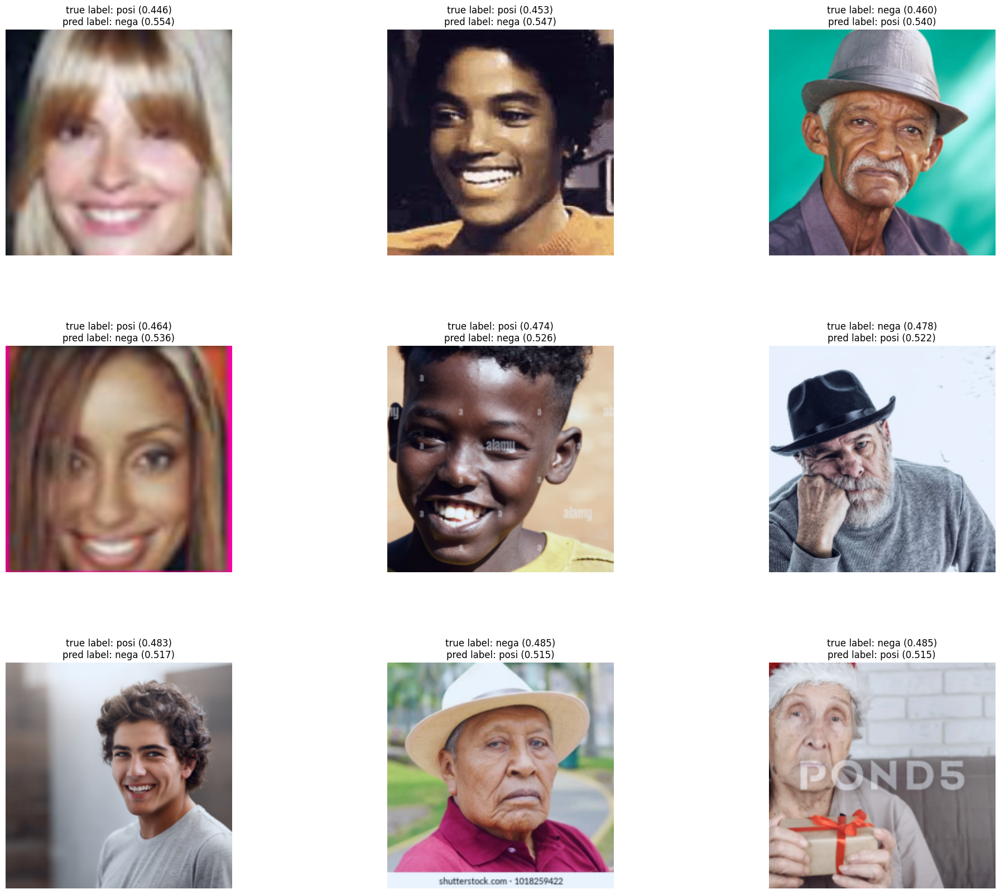

In [462]:
N_IMAGES = len(incorrect_examples)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

#### k_tre

In [463]:
testa_dir=name_dir+'/featureexploredataset/test/k_tre'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [464]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            # y_pred, _ = model(x)
            (y_pred_ensemble, _), log_priors  = model(x)######################################svgd

            y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
            y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            # y_pred=(y_pred_ensemble[0]+y_pred_ensemble[0])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [465]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [466]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([ True,  True,  True, False, False,  True,  True,  True, False,  True,
        False,  True, False, False,  True,  True, False, False])

In [467]:
len(corrects)- torch.sum(corrects)

tensor(8)

In [468]:
corrects.float().mean()


tensor(0.5556)

In [469]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [470]:
incorrect_examples

[(tensor([[[-0.3369, -0.3027, -0.2342,  ...,  0.9132,  1.0673,  1.1700],
           [-0.2856, -0.2513, -0.1828,  ...,  0.9646,  1.1187,  1.2043],
           [-0.2342, -0.1999, -0.1486,  ...,  1.0331,  1.1529,  1.2385],
           ...,
           [ 0.9132,  0.8447,  0.6906,  ..., -1.4158, -0.7479, -0.3712],
           [ 0.7419,  0.6734,  0.5536,  ..., -1.6727, -0.9705, -0.5596],
           [ 0.5536,  0.4851,  0.3652,  ..., -1.8610, -1.1247, -0.6965]],
  
          [[-0.6001, -0.5826, -0.5651,  ...,  1.0280,  0.6604,  0.4503],
           [-0.5651, -0.5476, -0.5301,  ...,  1.0980,  0.7129,  0.5028],
           [-0.5476, -0.5301, -0.5126,  ...,  1.1506,  0.7654,  0.5378],
           ...,
           [ 0.9230,  0.8179,  0.6429,  ..., -0.7227, -0.9678, -1.1078],
           [ 0.7654,  0.6779,  0.5028,  ..., -0.9503, -1.1954, -1.3179],
           [ 0.5903,  0.5028,  0.3452,  ..., -1.1429, -1.3704, -1.4930]],
  
          [[-0.9330, -0.8981, -0.8458,  ...,  1.3154,  1.1759,  1.1062],
           

In [471]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

0
8


0.0

In [472]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

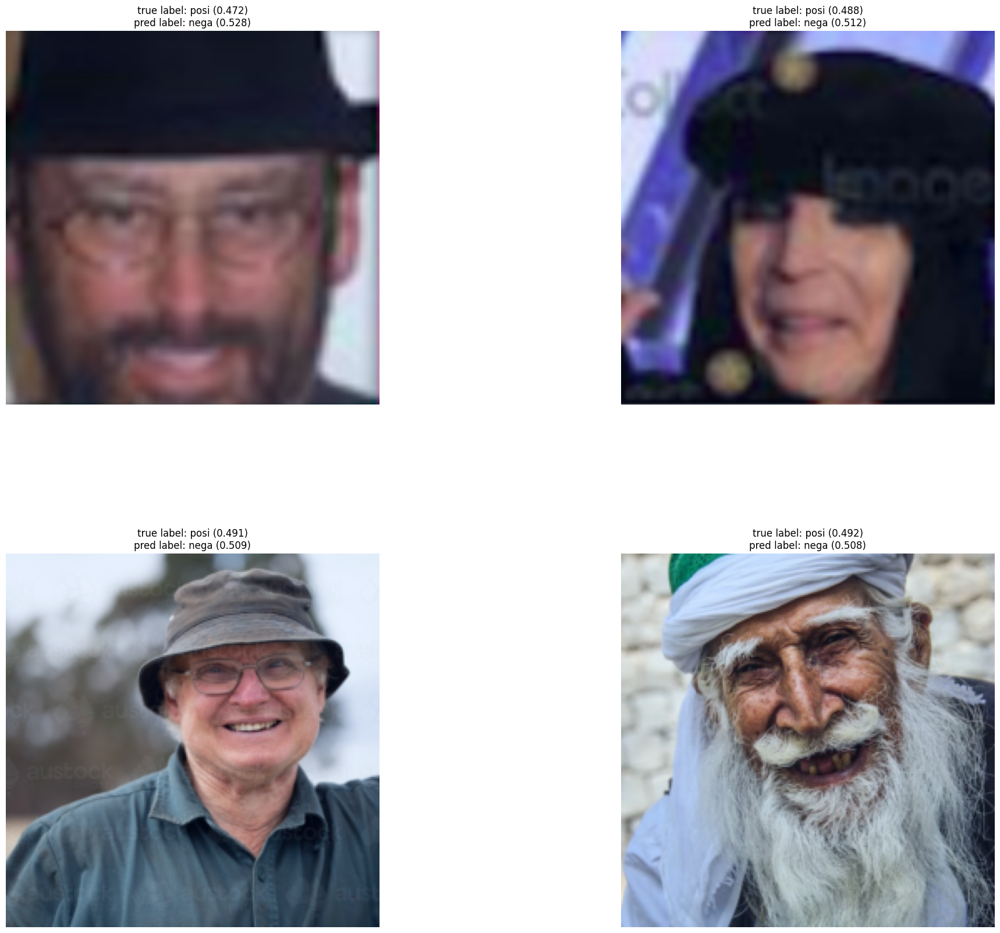

In [473]:
N_IMAGES = len(incorrect_examples)####(labels)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

#### k cuoi

In [474]:
testa_dir=name_dir+'/featureexploredataset/test/kcuoi'
# testa_dir='/content/drive/MyDrive/ambidata/featureexploredataset/testtrain'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [475]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            # y_pred, _ = model(x)
            (y_pred_ensemble, _), log_priors  = model(x)######################################svgd

            y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
            y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            # y_pred=(y_pred_ensemble[1]+y_pred_ensemble[1])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [476]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [477]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([ True,  True,  True,  True,  True,  True,  True,  True,  True,  True,
        False, False,  True, False,  True,  True,  True,  True,  True,  True,
         True,  True, False,  True, False,  True,  True, False,  True,  True,
         True,  True,  True,  True,  True,  True,  True, False,  True,  True,
         True, False,  True, False, False, False,  True,  True,  True,  True,
         True,  True, False])

In [478]:
len(corrects)- torch.sum(corrects)

tensor(12)

In [479]:
corrects.float().mean()

tensor(0.7736)

In [480]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:########## cmt nếu muốn show all
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [481]:
incorrect_examples

[(tensor([[[ 2.1119,  2.1119,  2.1119,  ...,  2.0777,  2.0777,  2.0777],
           [ 2.1119,  2.1119,  2.1119,  ...,  2.0777,  2.0777,  2.0777],
           [ 2.1119,  2.1119,  2.1119,  ...,  2.0777,  2.0777,  2.0777],
           ...,
           [-2.1008, -2.1008, -2.1008,  ..., -2.1008, -2.1008, -2.1008],
           [-2.1008, -2.1008, -2.1008,  ..., -2.1008, -2.1008, -2.1008],
           [-2.1008, -2.1008, -2.1008,  ..., -2.1008, -2.1008, -2.1008]],
  
          [[ 1.9384,  1.9384,  1.9384,  ...,  1.9034,  1.9034,  1.9034],
           [ 1.9384,  1.9384,  1.9384,  ...,  1.9034,  1.9034,  1.9034],
           [ 1.9384,  1.9384,  1.9384,  ...,  1.9034,  1.9034,  1.9034],
           ...,
           [-2.0182, -2.0182, -2.0182,  ..., -2.0182, -2.0182, -2.0182],
           [-2.0182, -2.0182, -2.0182,  ..., -2.0182, -2.0182, -2.0182],
           [-2.0182, -2.0182, -2.0182,  ..., -2.0182, -2.0182, -2.0182]],
  
          [[ 2.3611,  2.3611,  2.3611,  ...,  2.3263,  2.3263,  2.3263],
           

In [482]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

0
12


0.0

In [483]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

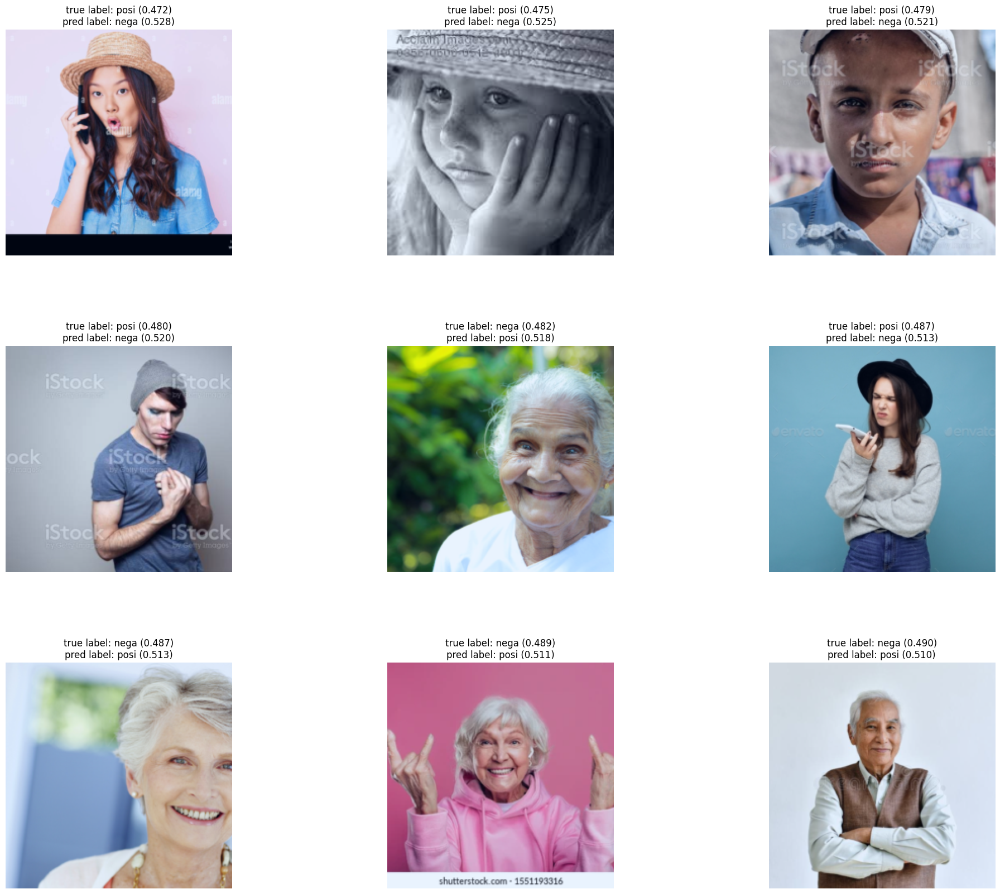

In [484]:
N_IMAGES = len(incorrect_examples)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

### Target test

#### k doi mu

In [485]:
testa_dir=name_dir+'/featureexploredataset/targettest/k_doi_mu'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [486]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            # y_pred, _ = model(x)
            (y_pred_ensemble, _), log_priors  = model(x)######################################svgd

            y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
            y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            # y_pred=(y_pred_ensemble[2]+y_pred_ensemble[2])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [487]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [488]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([ True,  True,  True,  True, False,  True,  True,  True,  True,  True,
        False,  True, False,  True,  True,  True,  True, False,  True,  True,
        False,  True, False,  True, False, False,  True, False,  True,  True,
         True, False,  True,  True,  True,  True, False,  True,  True, False,
        False, False,  True,  True,  True, False,  True,  True,  True,  True,
        False,  True,  True, False, False,  True,  True, False, False, False,
         True,  True,  True, False, False,  True,  True, False,  True,  True,
        False,  True,  True,  True, False, False,  True,  True, False,  True,
        False, False,  True,  True,  True,  True,  True,  True,  True,  True,
         True,  True, False, False,  True,  True,  True, False,  True,  True,
        False,  True,  True,  True,  True,  True,  True,  True, False,  True,
         True,  True,  True,  True, False,  True,  True,  True,  True,  True,
         True,  True,  True,  True,  True,  True,  True,  True, 

In [489]:
len(corrects)- torch.sum(corrects)

tensor(40)

In [490]:
corrects.float().mean()

tensor(0.8068)

In [491]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:########## cmt nếu muốn show all
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [492]:
incorrect_examples

[(tensor([[[ 1.1700,  1.2043,  1.2043,  ...,  1.2214,  1.2214,  1.2214],
           [ 1.1700,  1.2043,  1.2043,  ...,  1.2214,  1.2214,  1.2214],
           [ 1.1700,  1.2043,  1.2043,  ...,  1.2214,  1.2214,  1.2214],
           ...,
           [ 0.5364,  0.8618,  1.3755,  ...,  0.9303,  0.8618,  0.7933],
           [-0.3369, -0.6794,  0.1768,  ...,  0.8961,  0.8276,  0.7591],
           [-0.5767, -1.1589, -0.7479,  ...,  0.8961,  0.8276,  0.7591]],
  
          [[ 1.5007,  1.5357,  1.5357,  ...,  1.5532,  1.5532,  1.5532],
           [ 1.5007,  1.5357,  1.5357,  ...,  1.5532,  1.5532,  1.5532],
           [ 1.5007,  1.5357,  1.5357,  ...,  1.5532,  1.5532,  1.5532],
           ...,
           [ 0.9580,  1.4482,  2.0259,  ...,  1.3606,  1.3256,  1.2556],
           [ 0.1176, -0.0574,  0.8880,  ...,  1.3256,  1.2906,  1.2206],
           [-0.0749, -0.5126, -0.0399,  ...,  1.3256,  1.2906,  1.2206]],
  
          [[ 1.7511,  1.7860,  1.7860,  ...,  1.8034,  1.8034,  1.8034],
           

In [493]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

0
40


0.0

In [494]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

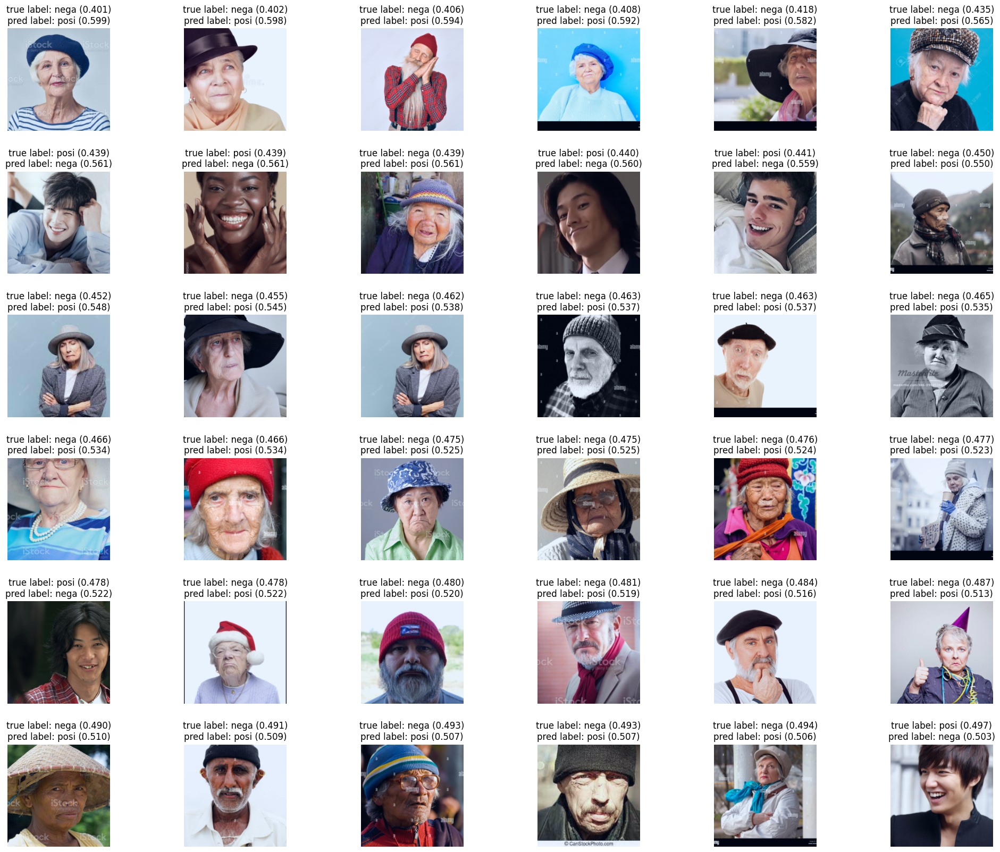

In [495]:
N_IMAGES = len(incorrect_examples)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

#### k_tre

In [496]:
testa_dir=name_dir+'/featureexploredataset/targettest/k_tre'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [497]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            # y_pred, _ = model(x)
            (y_pred_ensemble, _), log_priors  = model(x)######################################svgd

            y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
            y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            # y_pred=(y_pred_ensemble[0]+y_pred_ensemble[0])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [498]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [499]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([False, False,  True, False, False, False, False, False, False, False,
        False, False,  True, False, False, False, False,  True,  True, False,
        False,  True,  True, False, False,  True, False,  True, False, False,
        False,  True,  True,  True, False,  True, False,  True, False, False,
         True,  True, False,  True, False, False, False, False,  True, False,
         True,  True, False,  True, False,  True,  True,  True,  True, False,
        False,  True,  True,  True,  True,  True, False, False, False,  True,
         True,  True, False, False,  True,  True, False, False, False, False,
         True,  True,  True, False, False,  True,  True,  True,  True,  True,
        False, False, False, False,  True,  True,  True, False, False,  True,
         True, False, False, False, False, False,  True, False,  True,  True,
         True,  True,  True, False,  True,  True, False,  True, False,  True,
        False, False,  True, False, False,  True,  True,  True, 

In [500]:
len(corrects)- torch.sum(corrects)

tensor(94)

In [501]:
corrects.float().mean()


tensor(0.5628)

In [502]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [503]:
incorrect_examples

[(tensor([[[-1.7754, -1.8097, -1.8268,  ...,  0.4679, -0.7137, -1.3987],
           [-1.7754, -1.8097, -1.8268,  ...,  0.8104, -0.0116, -1.0733],
           [-1.7754, -1.7925, -1.7754,  ...,  0.7419,  0.5536, -0.5424],
           ...,
           [-1.9295, -1.9295, -1.9124,  ..., -1.8097, -1.9124, -1.9295],
           [-1.9295, -1.9295, -1.9124,  ..., -1.7412, -1.8610, -1.9124],
           [-1.9295, -1.9124, -1.9124,  ..., -1.6727, -1.8268, -1.8953]],
  
          [[-1.6681, -1.6856, -1.6681,  ...,  0.4503, -0.6702, -1.2829],
           [-1.6681, -1.7031, -1.6681,  ...,  0.7829,  0.0126, -0.9678],
           [-1.6681, -1.6856, -1.6506,  ...,  0.6954,  0.5378, -0.4776],
           ...,
           [-1.8256, -1.8256, -1.8081,  ..., -1.6331, -1.7556, -1.7906],
           [-1.8256, -1.8256, -1.8081,  ..., -1.5805, -1.7031, -1.7731],
           [-1.8256, -1.8081, -1.8081,  ..., -1.5105, -1.6681, -1.7556]],
  
          [[-1.4036, -1.4036, -1.4210,  ...,  0.3568, -0.5844, -1.1073],
           

In [504]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

1
94


0.010638297872340425

In [505]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

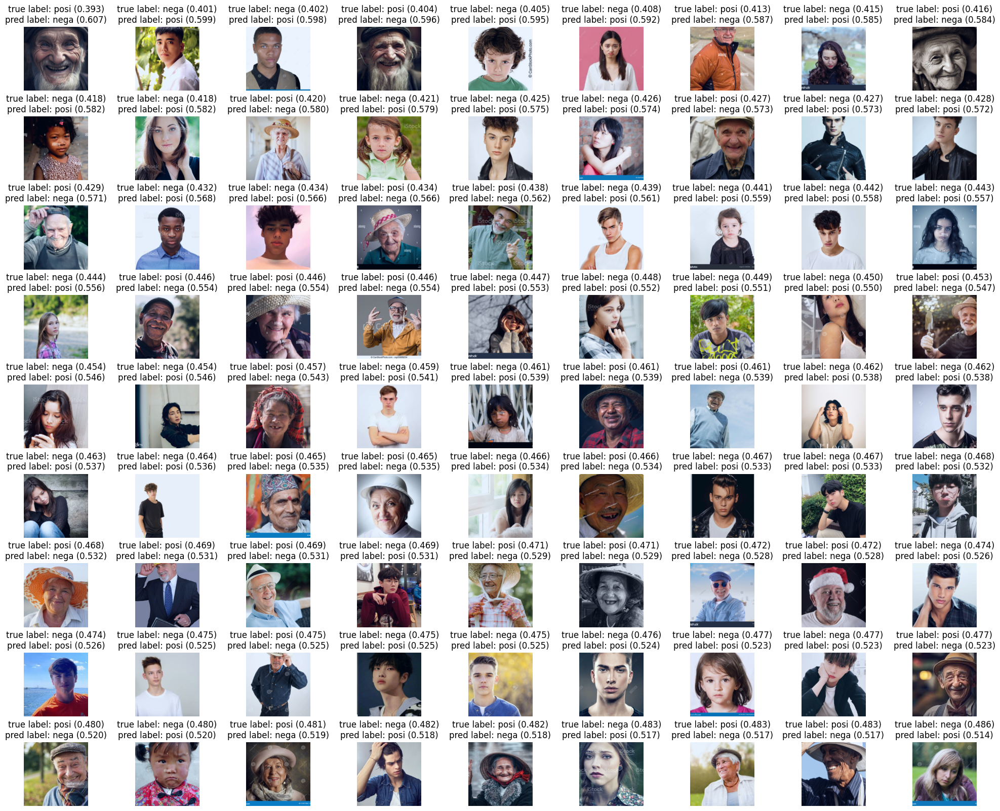

In [506]:
N_IMAGES = len(incorrect_examples)####(labels)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

#### k cuoi

In [507]:
testa_dir=name_dir+'/featureexploredataset/targettest/kcuoi'
# testa_dir='/content/drive/MyDrive/ambidata/featureexploredataset/testtrain'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [508]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            # y_pred, _ = model(x)
            (y_pred_ensemble, _), log_priors  = model(x)######################################svgd

            y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
            y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            # y_pred=(y_pred_ensemble[1]+y_pred_ensemble[1])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [509]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [510]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([ True, False, False,  True,  True, False,  True, False,  True,  True,
         True,  True,  True,  True,  True, False,  True, False,  True,  True,
         True, False, False,  True,  True,  True,  True, False, False,  True,
         True,  True, False,  True,  True, False,  True,  True,  True, False,
         True,  True,  True,  True,  True,  True,  True,  True, False,  True,
         True,  True,  True,  True, False,  True, False, False, False,  True,
         True,  True, False,  True,  True, False,  True,  True,  True,  True,
         True, False,  True,  True, False,  True,  True,  True,  True,  True,
        False,  True,  True,  True,  True,  True, False, False, False,  True,
         True, False,  True,  True,  True,  True,  True,  True, False,  True,
         True,  True,  True,  True,  True,  True,  True, False, False,  True,
         True,  True,  True,  True,  True,  True,  True,  True,  True,  True,
         True,  True, False,  True,  True,  True,  True,  True, 

In [511]:
len(corrects)- torch.sum(corrects)

tensor(38)

In [512]:
corrects.float().mean()

tensor(0.8071)

In [513]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:########## cmt nếu muốn show all
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [514]:
incorrect_examples

[(tensor([[[ 1.0673,  1.0844,  1.3413,  ...,  0.3652, -0.0972, -0.6281],
           [ 1.2557,  1.2214,  1.3413,  ...,  0.6734, -0.0629, -0.6281],
           [ 1.0673,  1.0159,  0.9817,  ...,  0.6563, -0.3369, -0.9020],
           ...,
           [-1.4329, -1.4329, -1.4329,  ..., -1.4329, -1.4329, -1.4329],
           [-1.4329, -1.4329, -1.4329,  ..., -1.4329, -1.4329, -1.4329],
           [-1.4329, -1.4329, -1.4329,  ..., -1.4329, -1.4329, -1.4329]],
  
          [[ 1.8158,  1.7458,  1.8683,  ...,  1.3957,  1.0455,  0.5203],
           [ 1.9209,  1.8859,  1.9209,  ...,  1.6057,  1.0280,  0.4678],
           [ 1.7108,  1.6933,  1.6758,  ...,  1.5707,  0.6954,  0.0476],
           ...,
           [-1.2129, -1.2129, -1.2129,  ..., -1.2129, -1.2129, -1.2129],
           [-1.2129, -1.2129, -1.2129,  ..., -1.2129, -1.2129, -1.2129],
           [-1.2129, -1.2129, -1.2129,  ..., -1.2129, -1.2129, -1.2129]],
  
          [[ 0.9319,  0.8797,  1.2457,  ..., -0.4798, -0.6018, -0.9853],
           

In [515]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

1
38


0.02631578947368421

In [516]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

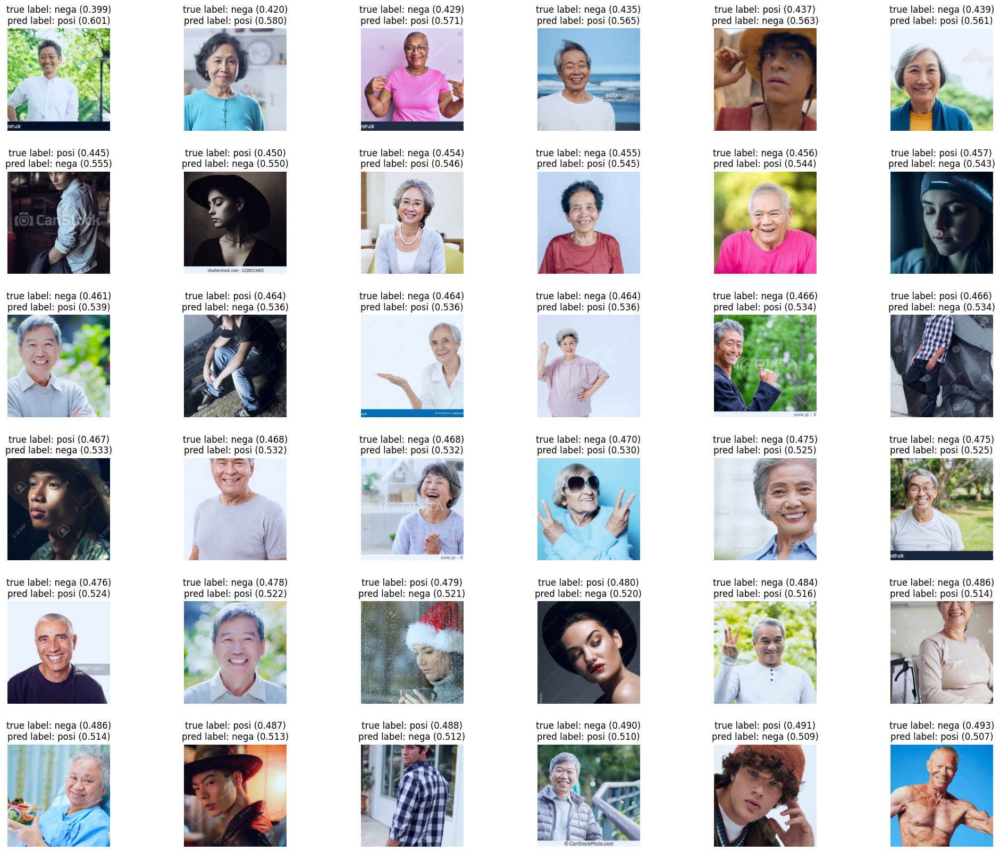

In [517]:
N_IMAGES = len(incorrect_examples)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

#Stage2

In [518]:
%cd name_dir


[Errno 2] No such file or directory: 'name_dir'
/content/drive/MyDrive/ambidata


In [519]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torch.optim.lr_scheduler as lr_scheduler
from torch.optim.lr_scheduler import _LRScheduler
import torch.utils.data as data

import torchvision.transforms as transforms
import torchvision.datasets as datasets
import torchvision.models as models

from sklearn import decomposition
from sklearn import manifold
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
import matplotlib.pyplot as plt
import numpy as np

import copy
from collections import namedtuple
import os
import random
import shutil
import time

In [520]:
train_dir= name_dir+'/featureexploredataset/train'
test_dir=name_dir+'/featureexploredataset/testtrain'

In [521]:

pretrained_size = 224
pretrained_means = [0.485, 0.456, 0.406]
pretrained_stds= [0.229, 0.224, 0.225]

train_transforms = transforms.Compose([
                          #  transforms.Resize(pretrained_size),
                           transforms.Resize((pretrained_size, pretrained_size)),
                           transforms.RandomRotation(5),
                           transforms.RandomHorizontalFlip(0.5),
                          #  transforms.RandomCrop(pretrained_size, padding = 10),
                           transforms.ToTensor(),
                           transforms.Normalize(mean = pretrained_means,
                                                std = pretrained_stds)
                       ])

test_transforms = transforms.Compose([
                           transforms.Resize(pretrained_size),
                           transforms.CenterCrop(pretrained_size),
                           transforms.ToTensor(),
                           transforms.Normalize(mean = pretrained_means,
                                                std = pretrained_stds)
                       ])

In [522]:
train_data = datasets.ImageFolder(root = train_dir,
                                  transform = train_transforms)

test_data = datasets.ImageFolder(root = test_dir,
                                 transform = test_transforms)
classes = train_data.classes
classes

['nega', 'posi']

In [523]:
VALID_RATIO = 0.9

n_train_examples = int(len(train_data) * VALID_RATIO)
n_valid_examples = len(train_data) - n_train_examples

train_data, valid_data = data.random_split(train_data,
                                           [n_train_examples, n_valid_examples])

In [524]:
valid_data = copy.deepcopy(valid_data)
valid_data.dataset.transform = test_transforms

In [525]:
print(f'Number of training examples: {len(train_data)}')
print(f'Number of validation examples: {len(valid_data)}')
print(f'Number of testing examples: {len(test_data)}')

Number of training examples: 225
Number of validation examples: 25
Number of testing examples: 66


In [526]:
BATCH_SIZE = 16

train_iterator = data.DataLoader(train_data,
                                 shuffle = True,
                                 batch_size = BATCH_SIZE)

valid_iterator = data.DataLoader(valid_data,
                                 batch_size = BATCH_SIZE)

test_iterator = data.DataLoader(test_data,
                                batch_size = BATCH_SIZE)

In [527]:
def normalize_image(image):
    image_min = image.min()
    image_max = image.max()
    image.clamp_(min = image_min, max = image_max)
    image.add_(-image_min).div_(image_max - image_min + 1e-5)
    return image

In [528]:
def plot_images(images, labels, classes, normalize = True):

    n_images = len(images)

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (15, 15))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image = images[i]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.permute(1, 2, 0).cpu().numpy())
        label = classes[labels[i]]
        ax.set_title(label)
        ax.axis('off')

In [529]:
len(train_data)

225

In [530]:
# N_IMAGES = 25##########225

# images, labels = zip(*[(image, label) for image, label in
#                            [testa_data[i] for i in [0,1,2,3,4,0,1,2,3,4,0,1,2,3,4,52,51,50,49,48,52,51,50,49,48]]])

# classes = ['negative', 'positive']#test_data.classes

# plot_images(images, labels, classes)

In [531]:
class ResNet(nn.Module):
    def __init__(self, config, output_dim):
        super().__init__()

        block, n_blocks, channels = config
        self.in_channels = channels[0]

        assert len(n_blocks) == len(channels) == 4

        self.conv1 = nn.Conv2d(3, self.in_channels, kernel_size = 7, stride = 2, padding = 3, bias = False)
        self.bn1 = nn.BatchNorm2d(self.in_channels)
        self.relu = nn.ReLU(inplace = True)
        self.maxpool = nn.MaxPool2d(kernel_size = 3, stride = 2, padding = 1)

        self.layer1 = self.get_resnet_layer(block, n_blocks[0], channels[0])
        self.layer2 = self.get_resnet_layer(block, n_blocks[1], channels[1], stride = 2)
        self.layer3 = self.get_resnet_layer(block, n_blocks[2], channels[2], stride = 2)
        self.layer4 = self.get_resnet_layer(block, n_blocks[3], channels[3], stride = 2)

        self.avgpool = nn.AdaptiveAvgPool2d((1,1))
        self.fc = nn.Linear(self.in_channels, output_dim)

    def get_resnet_layer(self, block, n_blocks, channels, stride = 1):

        layers = []

        if self.in_channels != block.expansion * channels:
            downsample = True
        else:
            downsample = False

        layers.append(block(self.in_channels, channels, stride, downsample))

        for i in range(1, n_blocks):
            layers.append(block(block.expansion * channels, channels))

        self.in_channels = block.expansion * channels

        return nn.Sequential(*layers)

    def forward(self, x):

        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)

        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)

        x = self.avgpool(x)
        h = x.view(x.shape[0], -1)
        h=F.normalize(h, dim=-1)#######
        x = self.fc(h)

        return x, h

In [532]:
ResNetConfig = namedtuple('ResNetConfig', ['block', 'n_blocks', 'channels'])

In [533]:
class Bottleneck(nn.Module):

    expansion = 4

    def __init__(self, in_channels, out_channels, stride = 1, downsample = False):
        super().__init__()

        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size = 1,
                               stride = 1, bias = False)
        self.bn1 = nn.BatchNorm2d(out_channels)

        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size = 3,
                               stride = stride, padding = 1, bias = False)
        self.bn2 = nn.BatchNorm2d(out_channels)

        self.conv3 = nn.Conv2d(out_channels, self.expansion * out_channels, kernel_size = 1,
                               stride = 1, bias = False)
        self.bn3 = nn.BatchNorm2d(self.expansion * out_channels)

        self.relu = nn.ReLU(inplace = True)

        if downsample:
            conv = nn.Conv2d(in_channels, self.expansion * out_channels, kernel_size = 1,
                             stride = stride, bias = False)
            bn = nn.BatchNorm2d(self.expansion * out_channels)
            downsample = nn.Sequential(conv, bn)
        else:
            downsample = None

        self.downsample = downsample

    def forward(self, x):

        i = x

        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)

        x = self.conv2(x)
        x = self.bn2(x)
        x = self.relu(x)

        x = self.conv3(x)
        x = self.bn3(x)

        if self.downsample is not None:
            i = self.downsample(i)

        x += i
        x = self.relu(x)

        return x

In [534]:
resnet50_config = ResNetConfig(block = Bottleneck,
                               n_blocks = [3, 4, 6, 3],
                               channels = [64, 128, 256, 512])

# resnet101_config = ResNetConfig(block = Bottleneck,
#                                 n_blocks = [3, 4, 23, 3],
#                                 channels = [64, 128, 256, 512])

# resnet152_config = ResNetConfig(block = Bottleneck,
#                                 n_blocks = [3, 8, 36, 3],
#                                 channels = [64, 128, 256, 512])

In [535]:
pretrained_model = models.resnet50(pretrained = True)

In [536]:
print(pretrained_model)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [537]:
IN_FEATURES = pretrained_model.fc.in_features
OUTPUT_DIM = len(test_data.classes)

fc = nn.Linear(IN_FEATURES, OUTPUT_DIM)

In [538]:
pretrained_model.fc = fc

In [539]:
model = ResNet(resnet50_config, OUTPUT_DIM)

In [540]:
model.load_state_dict(pretrained_model.state_dict())

<All keys matched successfully>

In [541]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The model has {count_parameters(model):,} trainable parameters')

The model has 23,512,130 trainable parameters


In [542]:
START_LR = 1e-8##1e-7

# optimizer = optim.Adam(model.parameters(), lr=START_LR)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

In [543]:
import torch.optim as optim#######################################################svgd
from torchvision import datasets, transforms
from torch.optim.lr_scheduler import StepLR

from torch.distributions import Categorical, Independent, MixtureSameFamily
from torch.distributions import Normal
from bayestorch.distributions import LogScaleNormal, SoftplusInvScaleNormal
from bayestorch.distributions import LogScaleNormal
from bayestorch.kernels import RBFSteinKernel
from bayestorch.losses import NLUPLoss
from bayestorch.models import ParticlePosteriorModel
from bayestorch.preconditioners import SVGD
option={}
option['checkpoint']="init_modelcls01.pt"#################None

SAMPLES=3
# Prior is defined as in https://arxiv.org/abs/1505.05424#############################svgd
num_parameters = sum(parameter.numel() for parameter in model.parameters())
# Prior arguments (WITHOUT gradient propagation)
normal_mixture_prior_weight=0.75
normal_mixture_prior_log_scale1=-1.0
normal_mixture_prior_log_scale2=-6.0
num_particles=SAMPLES
log_prior_weight=1e-9###################1.0/len(loader)#####################################min{2 × ReLU(t − 5), 20}#########1e-6
gamma=0.7
normal_mixture_prior_weight = torch.tensor(
    [normal_mixture_prior_weight, 1 - normal_mixture_prior_weight]
)
# mitb5=model.parameters().detach_().requires_grad_(True).unsqueeze(0)
# Inject sampled particle
mitb5=torch.zeros( num_parameters)
start_idx = 0
for parameter in model.parameters():
    num_elements = parameter.numel()
    mitb5[
        start_idx : start_idx + num_elements
    ].copy_(torch.flatten(parameter.data))###########################.requires_grad_(True)
    # mi.reshape_as(parameter).requires_grad_(False).detach_().copy_(parameter.data).requires_grad_(True)
    # parameter.detach_().requires_grad_(False).copy_(
    #     new_parameter
    # ).requires_grad_(True)
    start_idx += num_elements


normal_mixture_prior_loc =torch.stack(
    [mitb5, mitb5]
)######################################## torch.zeros((2, num_parameters), requires_grad=True)
normal_mixture_prior_log_scale1 = torch.full((num_parameters,), normal_mixture_prior_log_scale1)#########################################, requires_grad=True)
normal_mixture_prior_log_scale2 = torch.full((num_parameters,), normal_mixture_prior_log_scale2)#########################################, requires_grad=True)
normal_mixture_prior_log_scale = torch.stack(
    [normal_mixture_prior_log_scale1, normal_mixture_prior_log_scale2]
)


def get_rho(sigma, delta):
    """
    sigma is represented by softplus function  'sigma = log(1 + exp(rho))' to make sure it
    remains always positive and non-transformed 'rho' gets updated during backprop.
    """
    rho = torch.log(torch.expm1(delta * torch.abs(sigma)) + 1e-20)
    return rho
# Posterior arguments (WITH gradient propagation)
normal_posterior_loc = mitb5
normal_posterior_softplus_inv_scale =torch.log1p(torch.exp(get_rho(mitb5, 0.2)))####################################torch.ones_like(mitb5) ##############################torch.log1p(torch.exp(get_rho(mitb5, 0.2)))
# Bayesian model
model2 = ParticlePosteriorModel(
    model,
    # lambda weight, loc, log_scale: MixtureSameFamily(Categorical(weight), Independent(LogScaleNormal(loc, log_scale), 1)),
    # {"weight": normal_mixture_prior_weight, "loc": normal_mixture_prior_loc, "log_scale": normal_mixture_prior_log_scale},
    # SoftplusInvScaleNormal,
    # {"loc": normal_posterior_loc, "softplus_inv_scale": normal_posterior_softplus_inv_scale},
    Normal,
    {"loc": normal_posterior_loc, "scale": normal_posterior_softplus_inv_scale},
    num_particles,
)
model = ParticlePosteriorModel(
    model,
    lambda weight, loc, log_scale: MixtureSameFamily(Categorical(weight), Independent(LogScaleNormal(loc, log_scale), 1)),
    {"weight": normal_mixture_prior_weight, "loc": normal_mixture_prior_loc, "log_scale": normal_mixture_prior_log_scale},
    # SoftplusInvScaleNormal,
    # {"loc": normal_posterior_loc, "softplus_inv_scale": normal_posterior_softplus_inv_scale},
    # Normal,
    # {"loc": normal_posterior_loc, "scale": normal_posterior_softplus_inv_scale},
    num_particles,

)#####################.to(device)
for parameter ,parameter2 in zip(model.models.parameters(),model2.models.parameters()):
    parameter.data.copy_(parameter2.data)
# torch.save(model.state_dict(), "mnistmoi.pt")


if option['checkpoint'] is not None: #7################################################svgd 2
        model.load_state_dict(torch.load(option['checkpoint']))###############################, map_location=torch.device('cpu')
        print('Load checkpoint from {}'.format(option['checkpoint']))
kernel = RBFSteinKernel()
# SVGD preconditioner
preconditioner = SVGD(model.parameters(), kernel, num_particles)
print(model)############################################# thêm




# torch.save(model.state_dict(), "init_model.pt")

Load checkpoint from init_modelcls01.pt
ParticlePosteriorModel(model: ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Se

In [544]:
print([n for n, _ in model.named_children()])

['model', 'models']


In [545]:
param_optimizer = list(model.named_parameters())#test grad
[n for n, p in param_optimizer ]

['model.conv1.weight',
 'model.bn1.weight',
 'model.bn1.bias',
 'model.layer1.0.conv1.weight',
 'model.layer1.0.bn1.weight',
 'model.layer1.0.bn1.bias',
 'model.layer1.0.conv2.weight',
 'model.layer1.0.bn2.weight',
 'model.layer1.0.bn2.bias',
 'model.layer1.0.conv3.weight',
 'model.layer1.0.bn3.weight',
 'model.layer1.0.bn3.bias',
 'model.layer1.0.downsample.0.weight',
 'model.layer1.0.downsample.1.weight',
 'model.layer1.0.downsample.1.bias',
 'model.layer1.1.conv1.weight',
 'model.layer1.1.bn1.weight',
 'model.layer1.1.bn1.bias',
 'model.layer1.1.conv2.weight',
 'model.layer1.1.bn2.weight',
 'model.layer1.1.bn2.bias',
 'model.layer1.1.conv3.weight',
 'model.layer1.1.bn3.weight',
 'model.layer1.1.bn3.bias',
 'model.layer1.2.conv1.weight',
 'model.layer1.2.bn1.weight',
 'model.layer1.2.bn1.bias',
 'model.layer1.2.conv2.weight',
 'model.layer1.2.bn2.weight',
 'model.layer1.2.bn2.bias',
 'model.layer1.2.conv3.weight',
 'model.layer1.2.bn3.weight',
 'model.layer1.2.bn3.bias',
 'model.laye

In [546]:
FOUND_LR = 1e-4####1e-3

params = [
          {'params': model.models[0].conv1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.models[0].bn1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.models[0].layer1.parameters(), 'lr': FOUND_LR / 8},
          {'params': model.models[0].layer2.parameters(), 'lr': FOUND_LR / 6},
          {'params': model.models[0].layer3.parameters(), 'lr': FOUND_LR / 4},
          {'params': model.models[0].layer4.parameters(), 'lr': FOUND_LR / 2},
          {'params': model.models[0].fc.parameters()},
          {'params': model.models[1].conv1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.models[1].bn1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.models[1].layer1.parameters(), 'lr': FOUND_LR / 8},
          {'params': model.models[1].layer2.parameters(), 'lr': FOUND_LR / 6},
          {'params': model.models[1].layer3.parameters(), 'lr': FOUND_LR / 4},
          {'params': model.models[1].layer4.parameters(), 'lr': FOUND_LR / 2},
          {'params': model.models[1].fc.parameters()},
          {'params': model.models[2].conv1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.models[2].bn1.parameters(), 'lr': FOUND_LR / 10},
          {'params': model.models[2].layer1.parameters(), 'lr': FOUND_LR / 8},
          {'params': model.models[2].layer2.parameters(), 'lr': FOUND_LR / 6},
          {'params': model.models[2].layer3.parameters(), 'lr': FOUND_LR / 4},
          {'params': model.models[2].layer4.parameters(), 'lr': FOUND_LR / 2},
          {'params': model.models[2].fc.parameters()}
         ]


optimizer = optim.Adam(params, lr = FOUND_LR)

# optimizer = optim.Adam(model.parameters(), lr=START_LR)
print(f'The model has {count_parameters(model):,} trainable parameters')
optimizer2 = optim.Adam(params, lr = FOUND_LR*5)##################thêm

The model has 70,536,390 trainable parameters


In [547]:
EPOCHS = 20
STEPS_PER_EPOCH = len(train_iterator)
TOTAL_STEPS = EPOCHS * STEPS_PER_EPOCH

MAX_LRS = [p['lr'] for p in optimizer.param_groups]

scheduler = lr_scheduler.OneCycleLR(optimizer,
                                    max_lr = MAX_LRS,
                                    total_steps = TOTAL_STEPS)

In [548]:
def calculate_topk_accuracy(y_pred, y, k = 2):
    with torch.no_grad():
        batch_size = y.shape[0]
        _, top_pred = y_pred.topk(k, 1)
        top_pred = top_pred.t()
        correct = top_pred.eq(y.view(1, -1).expand_as(top_pred))
        # print(correct[:1])
        correct_1 = correct[:1].reshape(-1).float().sum(0, keepdim = True)
        correct_k = correct[:k].reshape(-1).float().sum(0, keepdim = True)
        acc_1 = correct_1 / batch_size
        acc_k = correct_k / batch_size
    return acc_1, correct[0:1].float().mean()

In [549]:
# def othologyloss(matrix):###################################BtB-I
#   matrix=matrix.view(matrix.shape[0]*matrix.shape[1],-1)
#   matrix2=torch.transpose(matrix,0,1)
#   return max(torch.norm(torch.matmul(matrix2,matrix), dim=1))


def othologyloss(matrix):###################################BtB-I
  # # matrix=matrix.view(matrix.shape[0]*matrix.shape[1],matrix.shape[2],-1)
  # # matrix2=torch.transpose(matrix,1,2)
  # # return torch.mean(torch.abs(torch.matmul(matrix,matrix2)-torch.eye(matrix.shape[1]).to(device)))####, dim=1))
  # matrix=torch.transpose(matrix,0,1)
  # # print(matrix.shape)
  # matrix=matrix.contiguous().view(matrix.shape[0],matrix.shape[1]*matrix.shape[2],-1)##https://stackoverflow.com/questions/66750391/runtimeerror-view-size-is-not-compatible-with-input-tensors-size-and-stride-a
  # matrix2=torch.transpose(matrix,1,2)
  # return torch.mean(torch.linalg.matrix_norm(torch.matmul(matrix,matrix2)-torch.eye(matrix.shape[1]).to(device), ord=2))#, dim=(- 2, - 1), keepdim=False, *, dtype=None, out=None)


  matrix=F.normalize(matrix, dim=2)
  matrix=torch.transpose(matrix,0,1)
  # print(matrix.shape)
  matrix2=torch.transpose(matrix,1,2)
  # print(matrix2.shape)
  matmulmatrix=torch.bmm(matrix,matrix2 )
  # print(matmulmatrix.shape)
  # print (matmulmatrix-torch.eye(matrix.shape[1]).to(device))
  matrix_norm=torch.linalg.matrix_norm(matmulmatrix.mean(dim=0)-torch.eye(matrix.shape[1]).to(device), ord=1)
  return torch.mean(matrix_norm)





In [550]:
# import torch
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# x=torch.rand(3, 16, 2048)
# othologyloss(x.to(device))#################################l2

In [551]:
########## thêm
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

def calculate_topk_accuracy(y_pred, y, k = 2):
    with torch.no_grad():
        batch_size = y.shape[0]
        _, top_pred = y_pred.topk(k, 1)
        top_pred = top_pred.t()
        correct = top_pred.eq(y.view(1, -1).expand_as(top_pred))
        # print(correct[:1])
        correct_1 = correct[:1].reshape(-1).float().sum(0, keepdim = True)
        correct_k = correct[:k].reshape(-1).float().sum(0, keepdim = True)
        acc_1 = correct_1 / batch_size
        acc_k = correct_k / batch_size
    return acc_1, correct[0:1].float().mean()

def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)
            y = y.to(device)

            # y_pred, _ = model(x)
            (y_pred_ensemble, _), log_priors  = model(x)######################################svgd

            y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
            y_pred=y_pred_ensemble.mean(dim=0)######################################svgd

            loss = criterion(y_pred, y)

            acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc_1 += acc_1.item()
            epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [552]:
model.load_state_dict(torch.load('tut5-'+modelname+'-stage1.pt'))

test_loss, test_acc_1, test_acc_5 = evaluate(model, test_iterator, criterion, device)

print(f'Test Loss: {test_loss:.3f} | Test Acc @1: {test_acc_1*100:6.2f}% | ' \
      f'Test Acc @5: {test_acc_5*100:6.2f}%')

Test Loss: 0.539 | Test Acc @1:  95.00% | Test Acc @5:  95.00%


### DivDIS Stage2

In [553]:
from torch.utils.data import ConcatDataset, DataLoader, Subset
from tqdm.auto import tqdm
# unlabeled_set = DatasetFolder("food-11/training/unlabeled", loader=lambda x: Image.open(x), extensions="jpg", transform=test_transforms)
# test_set = DatasetFolder("food-11/testing", loader=lambda x: Image.open(x), extensions="jpg", transform=test_tfm)
testa_dir=name_dir+'/featureexploredataset/test/k_doi_mu'
BATCH_SIZEa=8
testmu_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_dir=name_dir+'/featureexploredataset/test/k_tre'
testtre_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_dir=name_dir+'/featureexploredataset/test/kcuoi'
testcuoi_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testambi_datas=[testmu_data, testtre_data, testcuoi_data]


In [554]:
def get_pseudo_labels(dataset, model):
    batch_size=BATCH_SIZEa###################################thêm
    loader = DataLoader(dataset, batch_size=batch_size*3, shuffle=False, pin_memory=True)
    pseudo_labels = []
    for batch in tqdm(loader):
        # A batch consists of image data and corresponding labels.
        img, _ = batch

        # Forward the data
        # Using torch.no_grad() accelerates the forward process.
        with torch.no_grad():
            # logits = model(img.to(device))
            (logits, _), log_priors  = model(img.to(device))######################################svgd
            logits=logits.mean(dim=0)######################################svgd
            pseudo_labels.append(logits.argmax(dim=-1).detach().cpu())
        # Obtain the probability distributions by applying softmax on logits.
    pseudo_labels = torch.cat(pseudo_labels)
    # Update the labels by replacing with pseudo labels.
    for idx, ((img, _), pseudo_label) in enumerate(zip(dataset.samples, pseudo_labels)):
        dataset.samples[idx] = (img, pseudo_label.item())
    return dataset

In [555]:
testa_data=[]
for td in testambi_datas:
    testa_data.append(get_pseudo_labels(td, model))
testa_data=ConcatDataset(testa_data)
# testa_iterator = data.DataLoader(testa_data,
#                                 batch_size = BATCH_SIZEa)

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

In [556]:
VALID_RATIO = 0.9
BATCH_SIZEa=8

n_train_examples = int(len(testa_data) * VALID_RATIO)
n_valid_examples = len(testa_data) - n_train_examples

testa_data, valida_data = data.random_split(testa_data,
                                           [n_train_examples, n_valid_examples])
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)
valida_iterator = data.DataLoader(valida_data,
                                batch_size = BATCH_SIZEa)

###ambiguity test div BTB

In [557]:
# from divdis import DivDisLoss
# loss_fn = DivDisLoss(heads=num_particles+1)#(heads=num_particles)#(heads=num_particles+1)
# # loss_fntrain = DivDisLoss(heads=num_particles)#(heads=num_particles)#(heads=num_particles+1)
# def train(model, iterator,ambi_iterator, optimizer, criterion, scheduler, device):#####################thêm ambi_iterator

#     epoch_loss = 0
#     epoch_acc_1 = 0
#     epoch_acc_5 = 0

#     model.train()

#     for i, (x, y) in enumerate(iterator):###############################thêm enumerate i%5

#         x = x.to(device)
#         y = y.to(device)

#         optimizer.zero_grad()

#         # y_pred, _ = model(x)######################## _ là feature h
#         # print(model(x))
#         (y_pred_ensemble, _), log_priors  = model(x)######################################svgd
#         # print(y_pred_ensemble.shape)
#         # print(_.shape)
#         y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)

#         y_pred=y_pred_ensemble.mean(dim=0)######################################svgd

#         loss = criterion(y_pred, y)
#         loss_e1 = criterion(y_pred_ensemble[0], y)######################################svgd1
#         loss_e2 = criterion(y_pred_ensemble[1], y)######################################svgd1
#         loss_e3 = criterion(y_pred_ensemble[2], y)######################################svgd1
#         loss=loss+loss_e1+loss_e2+loss_e3######################################svgd1
#         # #####################divdis
#         # output_tran=torch.transpose(y_pred_ensemble, 0, 1)
#         # # output_tran=torch.transpose(torch.cat((y_pred_ensemble, y_pred_ensemble.mean(dim=0).unsqueeze(0)), 0), 0, 1)
#         # # output_tran=torch.transpose(torch.cat((y_pred_ensemble,torch.tensor([0.5,0.5]).unsqueeze(0).expand(y_pred_ensemble.shape[1],-1).unsqueeze(0).to(device)),0), 0, 1)
#         # loss-=loss_fntrain(output_tran)*100
#         # #######################\divdis
#         # lossdiv=othologyloss(_)###################################BTB
#         # print(loss, lossdiv)
#         # # loss+=0.3*lossdiv######################################BTB  tensor(8.1179, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2842, device='cuda:0', grad_fn=<MeanBackward0>) hội tụ thì tensor(0.6532, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2629, device='cuda:0', grad_fn=<MeanBackward0>)
#         # loss+=0.0001*lossdiv#######0001#################################################tensor(7.2617, device='cuda:0', grad_fn=<AddBackward0>) tensor(809.6948, device='cuda:0', grad_fn=<MeanBackward0>) hội tụ 0.3 thì
#         acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

#         # kl=log_priors
#         # kl=1e-8*(-kl)#############################################311:2,7############################svgd
#         # # kl.mean(0).backward()############################svgd
#         # print(loss, kl)
#         # loss+=kl.mean(0)

#         loss.backward()
#         preconditioner.step()############################# svgd

#         optimizer.step()

#         scheduler.step()

#         epoch_loss += loss.item()
#         epoch_acc_1 += acc_1.item()
#         epoch_acc_5 += acc_5.item()


#         ####thêm
#         if((i+1)%5==0):
#             for (x, y) in ambi_iterator:
#                 x = x.to(device)
#                 y = y.to(device)

#                 optimizer.zero_grad()
#                 (y_pred_ensemble, _), log_priors  = model(x)
#                 y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
#                 # #####################divdis
#                 # # output_tran=torch.transpose(y_pred_ensemble, 0, 1)
#                 # # output_tran=torch.transpose(torch.cat((y_pred_ensemble, y_pred_ensemble.mean(dim=0).unsqueeze(0)), 0), 0, 1)
#                 # output_tran=torch.transpose(torch.cat((y_pred_ensemble,torch.tensor([0.5,0.5]).unsqueeze(0).expand(y_pred_ensemble.shape[1],-1).unsqueeze(0).to(device)),0), 0, 1)
#                 # loss=loss_fn(output_tran)*100
#                 # #######################\divdis
#                 y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
#                 lossconst=(y_pred-0.5)**2
#                 loss=lossconst.mean()*10000############lấy pretrain
#                 # loss+=lossconst.mean()
#                 # lossreg=(y_pred_ensemble-0.5)**2*1000############lấy finetuning
#                 # loss-=lossreg.mean()



#                 # lossdiv=othologyloss(y_pred_ensemble)###################################BTB
#                 # print("divdis",loss, lossdiv)
#                 # # loss+=0.3*lossdiv######################################BTB  tensor(8.1179, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2842, device='cuda:0', grad_fn=<MeanBackward0>) hội tụ thì tensor(0.6532, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2629, device='cuda:0', grad_fn=<MeanBackward0>)
#                 # loss+=0.0001*lossdiv#######0001#################################################tensor(7.2617, device='cuda:0', grad_fn=<AddBackward0>) tensor(809.6948, device='cuda:0', grad_fn=<MeanBackward0>) hội tụ 0.3 thì
#                 loss.backward()
#                 preconditioner.step()############################# svgd ############lấy pretrain

#                 optimizer2.step()

#                 # scheduler.step()


#     epoch_loss /= len(iterator)
#     epoch_acc_1 /= len(iterator)
#     epoch_acc_5 /= len(iterator)

#     return epoch_loss, epoch_acc_1, epoch_acc_5

In [558]:
# def evaluate(model, iterator,ambi_iterator, criterion, device):

#     epoch_loss = 0
#     epoch_acc_1 = 0
#     epoch_acc_5 = 0

#     model.eval()

#     with torch.no_grad():

#         for (x, y) in iterator:

#             x = x.to(device)
#             y = y.to(device)

#             # y_pred, _ = model(x)
#             (y_pred_ensemble, _), log_priors  = model(x)######################################svgd
#             y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
#             loss_e1 = criterion(y_pred_ensemble[0], y)######################################svgd1
#             loss_e2 = criterion(y_pred_ensemble[1], y)######################################svgd1
#             loss_e3 = criterion(y_pred_ensemble[2], y)######################################svgd1

#             y_pred=y_pred_ensemble.mean(dim=0)######################################svgd

#             loss = criterion(y_pred, y)
#             loss=loss+loss_e1+loss_e2+loss_e3######################################svgd1
#             # lossdiv=othologyloss(_)###################################BTB
#             # loss+=0.0001*lossdiv

#             acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

#             epoch_loss += loss.item()
#             epoch_acc_1 += acc_1.item()
#             epoch_acc_5 += acc_5.item()
#         ###thêm
#         for (x, y) in ambi_iterator:
#             x = x.to(device)
#             y = y.to(device)

#             optimizer.zero_grad()
#             (y_pred_ensemble, _), log_priors  = model(x)
#             y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
#             # #####################divdis
#             # # output_tran=torch.transpose(y_pred_ensemble.softmax(dim=-1), 0, 1)
#             # # output_tran=torch.transpose(torch.cat((y_pred_ensemble, y_pred_ensemble.mean(dim=0).unsqueeze(0)), 0).softmax(dim=-1), 0, 1)
#             # output_tran=torch.transpose(torch.cat((y_pred_ensemble.softmax(dim=-1),torch.tensor([0.5,0.5]).unsqueeze(0).expand(y_pred_ensemble.shape[1],-1).unsqueeze(0).to(device)),0), 0, 1)
#             # loss=loss_fn(output_tran)*100
#             # #######################\divdis
#             # y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
#             # lossconst=(y_pred.softmax(dim=-1)-0.5)**2
#             # loss+=lossconst.mean()
#             # lossreg=(y_pred_ensemble.softmax(dim=-1)-0.5)**2
#             # loss-=lossreg.mean()*10
#             ####tăn uncer
#             y_pred=y_pred_ensemble.mean(dim=0)
#             lossconst=(y_pred.softmax(dim=-1)-0.5)**2#*1000
#             loss=lossconst.mean()

#             epoch_loss+= loss.item()


#     epoch_loss /= len(iterator)
#     epoch_acc_1 /= len(iterator)
#     epoch_acc_5 /= len(iterator)

#     return epoch_loss, epoch_acc_1, epoch_acc_5

In [559]:
# torch.save(model.state_dict(), 'tut5-model12-stage1.pt')

In [560]:
from divdis import DivDisLoss
loss_fn = DivDisLoss(heads=num_particles+1)#(heads=num_particles)#(heads=num_particles+1)
# loss_fntrain = DivDisLoss(heads=num_particles)#(heads=num_particles)#(heads=num_particles+1)
def train(model, iterator,ambi_iterator, optimizer, criterion, scheduler, device):#####################thêm ambi_iterator

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.train()

    for i, (x, y) in enumerate(iterator):###############################thêm enumerate i%5

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        # y_pred, _ = model(x)######################## _ là feature h
        # print(model(x))
        (y_pred_ensemble, _), log_priors  = model(x)######################################svgd
        # print(y_pred_ensemble.shape)
        # print(_.shape)
        y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)

        y_pred=y_pred_ensemble.mean(dim=0)######################################svgd

        loss = criterion(y_pred, y)
        loss_e1 = criterion(y_pred_ensemble[0], y)######################################svgd1
        loss_e2 = criterion(y_pred_ensemble[1], y)######################################svgd1
        loss_e3 = criterion(y_pred_ensemble[2], y)######################################svgd1
        loss=loss+loss_e1+loss_e2+loss_e3######################################svgd1
        # #####################divdis
        # output_tran=torch.transpose(y_pred_ensemble, 0, 1)
        # # output_tran=torch.transpose(torch.cat((y_pred_ensemble, y_pred_ensemble.mean(dim=0).unsqueeze(0)), 0), 0, 1)
        # # output_tran=torch.transpose(torch.cat((y_pred_ensemble,torch.tensor([0.5,0.5]).unsqueeze(0).expand(y_pred_ensemble.shape[1],-1).unsqueeze(0).to(device)),0), 0, 1)
        # loss-=loss_fntrain(output_tran)*100
        # #######################\divdis
        # lossdiv=othologyloss(_)###################################BTB
        # print(loss, lossdiv)
        # # loss+=0.3*lossdiv######################################BTB  tensor(8.1179, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2842, device='cuda:0', grad_fn=<MeanBackward0>) hội tụ thì tensor(0.6532, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2629, device='cuda:0', grad_fn=<MeanBackward0>)
        # loss+=0.0001*lossdiv#######0001#################################################tensor(7.2617, device='cuda:0', grad_fn=<AddBackward0>) tensor(809.6948, device='cuda:0', grad_fn=<MeanBackward0>) hội tụ 0.3 thì
        acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

        # kl=log_priors
        # kl=1e-8*(-kl)#############################################311:2,7############################svgd
        # # kl.mean(0).backward()############################svgd
        # print(loss, kl)
        # loss+=kl.mean(0)

        loss.backward()
        preconditioner.step()############################# svgd

        optimizer.step()

        scheduler.step()

        epoch_loss += loss.item()
        epoch_acc_1 += acc_1.item()
        epoch_acc_5 += acc_5.item()


        ####thêm
        if((i+1)%5==0):
            for (x, y) in ambi_iterator:
                x = x.to(device)
                y = y.to(device)

                # optimizer.zero_grad()##### ICPR tích lũy grad
                (y_pred_ensemble, _), log_priors  = model(x)
                y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
                #####################divdis
                # output_tran=torch.transpose(y_pred_ensemble, 0, 1)
                # output_tran=torch.transpose(torch.cat((y_pred_ensemble, y_pred_ensemble.mean(dim=0).unsqueeze(0)), 0), 0, 1)
                output_tran=torch.transpose(torch.cat((y_pred_ensemble,torch.tensor([0.5,0.5]).unsqueeze(0).expand(y_pred_ensemble.shape[1],-1).unsqueeze(0).to(device)),0), 0, 1)
                loss=loss_fn(output_tran)*100
                #######################\divdis
                y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
                lossconst=(y_pred-0.5)**2
                # loss=lossconst.mean()##*10000############lấy pretrain
                loss+=lossconst.mean()
                # lossreg=(y_pred_ensemble-0.5)**2*1000############lấy finetuning
                lossreg=torch.max(torch.norm(y_pred_ensemble, p=2, dim=2), dim=0).values
                loss-=lossreg.mean()



                lossdiv=othologyloss(y_pred_ensemble)###################################BTB
                print("divdis",loss, lossdiv)
                # loss+=0.3*lossdiv######################################BTB  tensor(8.1179, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2842, device='cuda:0', grad_fn=<MeanBackward0>) hội tụ thì tensor(0.6532, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2629, device='cuda:0', grad_fn=<MeanBackward0>)
                loss+=lossdiv#######0001#################################################tensor(7.2617, device='cuda:0', grad_fn=<AddBackward0>) tensor(809.6948, device='cuda:0', grad_fn=<MeanBackward0>) hội tụ 0.3 thì
                loss.backward()
                # preconditioner.step()############################# svgd ############lấy pretrain



                # scheduler.step()
            optimizer2.step()


    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [561]:
def evaluate(model, iterator,ambi_iterator, criterion, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)
            y = y.to(device)

            # y_pred, _ = model(x)
            (y_pred_ensemble, _), log_priors  = model(x)######################################svgd
            y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
            loss_e1 = criterion(y_pred_ensemble[0], y)######################################svgd1
            loss_e2 = criterion(y_pred_ensemble[1], y)######################################svgd1
            loss_e3 = criterion(y_pred_ensemble[2], y)######################################svgd1

            y_pred=y_pred_ensemble.mean(dim=0)######################################svgd

            loss = criterion(y_pred, y)
            loss=loss+loss_e1+loss_e2+loss_e3######################################svgd1
            # lossdiv=othologyloss(_)###################################BTB
            # loss+=0.0001*lossdiv

            acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc_1 += acc_1.item()
            epoch_acc_5 += acc_5.item()
        ###thêm
        for (x, y) in ambi_iterator:
            x = x.to(device)
            y = y.to(device)

            optimizer.zero_grad()
            (y_pred_ensemble, _), log_priors  = model(x)
            y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
            #####################divdis
            # output_tran=torch.transpose(y_pred_ensemble.softmax(dim=-1), 0, 1)
            # output_tran=torch.transpose(torch.cat((y_pred_ensemble, y_pred_ensemble.mean(dim=0).unsqueeze(0)), 0).softmax(dim=-1), 0, 1)
            # output_tran=torch.transpose(torch.cat((y_pred_ensemble.softmax(dim=-1),torch.tensor([0.5,0.5]).unsqueeze(0).expand(y_pred_ensemble.shape[1],-1).unsqueeze(0).to(device)),0), 0, 1)
            # loss=loss_fn(output_tran)*100
            # #######################\divdis
            y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            lossconst=(y_pred.softmax(dim=-1)-0.5)**2
            loss=lossconst.mean()
            lossreg=(y_pred_ensemble.softmax(dim=-1)-0.5)**2
            loss-=lossreg.mean()*10
            # ####tăn uncer
            # y_pred=y_pred_ensemble.mean(dim=0)
            # lossconst=(y_pred.softmax(dim=-1)-0.5)**2
            # loss=lossconst.mean()

            epoch_loss+= loss.item()


    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [562]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [563]:
best_valid_loss = float('inf')

for epoch in range(EPOCHS):

    start_time = time.monotonic()

    train_loss, train_acc_1, train_acc_5 = train(model, train_iterator,testa_iterator, optimizer, criterion, scheduler, device)##########thêm ambi_iterator
    valid_loss, valid_acc_1, valid_acc_5 = evaluate(model, valid_iterator,valida_iterator, criterion, device)

    if valid_loss < best_valid_loss:
        best_valid_loss = valid_loss
        torch.save(model.state_dict(), 'tut5-model.pt')

    end_time = time.monotonic()

    epoch_mins, epoch_secs = epoch_time(start_time, end_time)

    print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
    print(f'\tTrain Loss: {train_loss:.3f} | Train Acc @1: {train_acc_1*100:6.2f}% | ' \
          f'Train Acc @5: {train_acc_5*100:6.2f}%')
    print(f'\tValid Loss: {valid_loss:.3f} | Valid Acc @1: {valid_acc_1*100:6.2f}% | ' \
          f'Valid Acc @5: {valid_acc_5*100:6.2f}%')

divdis tensor(-0.6384, device='cuda:0', grad_fn=<SubBackward0>) tensor(1.8457, device='cuda:0', grad_fn=<MeanBackward0>)
divdis tensor(-0.7249, device='cuda:0', grad_fn=<SubBackward0>) tensor(1.8656, device='cuda:0', grad_fn=<MeanBackward0>)
divdis tensor(-0.6883, device='cuda:0', grad_fn=<SubBackward0>) tensor(1.7388, device='cuda:0', grad_fn=<MeanBackward0>)
divdis tensor(-0.7289, device='cuda:0', grad_fn=<SubBackward0>) tensor(1.7839, device='cuda:0', grad_fn=<MeanBackward0>)
divdis tensor(-0.6925, device='cuda:0', grad_fn=<SubBackward0>) tensor(1.8638, device='cuda:0', grad_fn=<MeanBackward0>)
divdis tensor(-0.6502, device='cuda:0', grad_fn=<SubBackward0>) tensor(1.8135, device='cuda:0', grad_fn=<MeanBackward0>)
divdis tensor(-0.7528, device='cuda:0', grad_fn=<SubBackward0>) tensor(1.8091, device='cuda:0', grad_fn=<MeanBackward0>)
divdis tensor(-0.7271, device='cuda:0', grad_fn=<SubBackward0>) tensor(1.8487, device='cuda:0', grad_fn=<MeanBackward0>)
divdis tensor(-0.6079, device='c

In [564]:
a=torch.Tensor([[[0.5400, 0.4600], [0.6928, 0.3072], [0.3290, 0.6710], [0.2643, 0.7357], [0.5694, 0.4306], [0.6667, 0.3333], [0.5419, 0.4581], [0.6809, 0.3191]], [[0.4993, 0.5007], [0.4582, 0.5418], [0.5232, 0.4768], [0.6525, 0.3475], [0.4505, 0.5495], [0.3461, 0.6539], [0.5360, 0.4640], [0.3309, 0.6691]], [[0.4333, 0.5667], [0.3303, 0.6697], [0.6519, 0.3481], [0.6469, 0.3531], [0.4580, 0.5420], [0.4077, 0.5923], [0.4362, 0.5638], [0.4410, 0.5590]]])

In [565]:
a.requires_grad=True

In [566]:
a.shape

torch.Size([3, 8, 2])

In [567]:
value, index=torch.max(torch.norm(a, p=2, dim=2), dim=0)
index

tensor([2, 0, 0, 0, 0, 0, 2, 0])

In [568]:
mask= index==2
mask

tensor([ True, False, False, False, False, False,  True, False])

In [569]:
index*mask

tensor([2, 0, 0, 0, 0, 0, 2, 0])

In [570]:
value

tensor([0.7134, 0.7579, 0.7473, 0.7817, 0.7139, 0.7454, 0.7128, 0.7520],
       grad_fn=<MaxBackward0>)

In [571]:
b=torch.norm(a, p=2, dim=2)
b

tensor([[0.7094, 0.7579, 0.7473, 0.7817, 0.7139, 0.7454, 0.7096, 0.7520],
        [0.7071, 0.7096, 0.7079, 0.7393, 0.7106, 0.7398, 0.7089, 0.7465],
        [0.7134, 0.7467, 0.7390, 0.7370, 0.7096, 0.7191, 0.7128, 0.7120]],
       grad_fn=<LinalgVectorNormBackward0>)

In [572]:
b.gather(0,index.unsqueeze(0))

tensor([[0.7134, 0.7579, 0.7473, 0.7817, 0.7139, 0.7454, 0.7128, 0.7520]],
       grad_fn=<GatherBackward0>)

In [573]:
c= b.gather(0,index.unsqueeze(0))*mask.unsqueeze(0)##########https://discuss.pytorch.org/t/is-multiplying-loss-by-0-0-the-same-as-not-having-the-loss/165078/2
c

tensor([[0.7134, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.7128, 0.0000]],
       grad_fn=<MulBackward0>)

In [574]:
# d=-torch.sum(c)
d=torch.sum(-c)
d.backward()

In [575]:
a.grad

tensor([[[ 0.0000,  0.0000],
         [ 0.0000,  0.0000],
         [ 0.0000,  0.0000],
         [ 0.0000,  0.0000],
         [ 0.0000,  0.0000],
         [ 0.0000,  0.0000],
         [ 0.0000,  0.0000],
         [ 0.0000,  0.0000]],

        [[ 0.0000,  0.0000],
         [ 0.0000,  0.0000],
         [ 0.0000,  0.0000],
         [ 0.0000,  0.0000],
         [ 0.0000,  0.0000],
         [ 0.0000,  0.0000],
         [ 0.0000,  0.0000],
         [ 0.0000,  0.0000]],

        [[-0.6074, -0.7944],
         [ 0.0000,  0.0000],
         [ 0.0000,  0.0000],
         [ 0.0000,  0.0000],
         [ 0.0000,  0.0000],
         [ 0.0000,  0.0000],
         [-0.6119, -0.7909],
         [ 0.0000,  0.0000]]])

In [576]:
a

tensor([[[0.5400, 0.4600],
         [0.6928, 0.3072],
         [0.3290, 0.6710],
         [0.2643, 0.7357],
         [0.5694, 0.4306],
         [0.6667, 0.3333],
         [0.5419, 0.4581],
         [0.6809, 0.3191]],

        [[0.4993, 0.5007],
         [0.4582, 0.5418],
         [0.5232, 0.4768],
         [0.6525, 0.3475],
         [0.4505, 0.5495],
         [0.3461, 0.6539],
         [0.5360, 0.4640],
         [0.3309, 0.6691]],

        [[0.4333, 0.5667],
         [0.3303, 0.6697],
         [0.6519, 0.3481],
         [0.6469, 0.3531],
         [0.4580, 0.5420],
         [0.4077, 0.5923],
         [0.4362, 0.5638],
         [0.4410, 0.5590]]], requires_grad=True)

In [577]:
torch.save(model.state_dict(), 'tut5-'+modelname+'-stage2.pt')

In [578]:
########## thêm
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

criterion = nn.CrossEntropyLoss()

model = model.to(device)
criterion = criterion.to(device)

def calculate_topk_accuracy(y_pred, y, k = 2):
    with torch.no_grad():
        batch_size = y.shape[0]
        _, top_pred = y_pred.topk(k, 1)
        top_pred = top_pred.t()
        correct = top_pred.eq(y.view(1, -1).expand_as(top_pred))
        # print(correct[:1])
        correct_1 = correct[:1].reshape(-1).float().sum(0, keepdim = True)
        correct_k = correct[:k].reshape(-1).float().sum(0, keepdim = True)
        acc_1 = correct_1 / batch_size
        acc_k = correct_k / batch_size
    return acc_1, correct[0:1].float().mean()

def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc_1 = 0
    epoch_acc_5 = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)
            y = y.to(device)

            # y_pred, _ = model(x)
            (y_pred_ensemble, _), log_priors  = model(x)######################################svgd

            y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
            y_pred=y_pred_ensemble.mean(dim=0)######################################svgd

            loss = criterion(y_pred, y)

            acc_1, acc_5 = calculate_topk_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc_1 += acc_1.item()
            epoch_acc_5 += acc_5.item()

    epoch_loss /= len(iterator)
    epoch_acc_1 /= len(iterator)
    epoch_acc_5 /= len(iterator)

    return epoch_loss, epoch_acc_1, epoch_acc_5

In [579]:
model.load_state_dict(torch.load('tut5-'+modelname+'-stage2.pt'))

test_loss, test_acc_1, test_acc_5 = evaluate(model, test_iterator, criterion, device)

print(f'Test Loss: {test_loss:.3f} | Test Acc @1: {test_acc_1*100:6.2f}% | ' \
      f'Test Acc @5: {test_acc_5*100:6.2f}%')

Test Loss: 0.446 | Test Acc @1:  96.25% | Test Acc @5:  96.25%


#### k doi mu

In [580]:
testa_dir=name_dir+'/featureexploredataset/test/k_doi_mu'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [581]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            # y_pred, _ = model(x)
            (y_pred_ensemble, _), log_priors  = model(x)######################################svgd

            y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
            y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            # y_pred=(y_pred_ensemble[2]+y_pred_ensemble[2])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [582]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [583]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([ True,  True,  True,  True,  True, False, False, False,  True, False,
        False, False,  True,  True,  True, False, False,  True,  True,  True,
         True, False,  True,  True, False, False,  True])

In [584]:
len(corrects)- torch.sum(corrects)

tensor(11)

In [585]:
corrects.float().mean()

tensor(0.5926)

In [586]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:########## cmt nếu muốn show all
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [587]:
incorrect_examples

[(tensor([[[ 0.7762,  0.7762,  0.7591,  ...,  1.3755,  1.3242,  1.2557],
           [ 0.7419,  0.7419,  0.7591,  ...,  1.1015,  1.0502,  0.9646],
           [ 0.7419,  0.7248,  0.7419,  ...,  0.7933,  0.7419,  0.6563],
           ...,
           [-0.6965, -0.6965, -0.6965,  ...,  0.8447,  0.6906,  0.4337],
           [-0.7137, -0.6965, -0.6965,  ...,  0.8447,  0.8104,  0.5536],
           [-0.6794, -0.6965, -0.6965,  ...,  0.8447,  0.7933,  0.6221]],
  
          [[ 0.6254,  0.6254,  0.5903,  ...,  1.4657,  1.3957,  1.3256],
           [ 0.5903,  0.5903,  0.5903,  ...,  1.1681,  1.0980,  1.0280],
           [ 0.5903,  0.5728,  0.5728,  ...,  0.8004,  0.7479,  0.6604],
           ...,
           [-0.8627, -0.8803, -0.8803,  ...,  0.9405,  0.7479,  0.4503],
           [-0.8803, -0.8627, -0.8803,  ...,  0.9405,  0.8880,  0.6078],
           [-0.8803, -0.8803, -0.8803,  ...,  0.9405,  0.8880,  0.6954]],
  
          [[ 0.5659,  0.5659,  0.5485,  ...,  1.6117,  1.5420,  1.4722],
           

In [588]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

4
11


0.36363636363636365

In [589]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

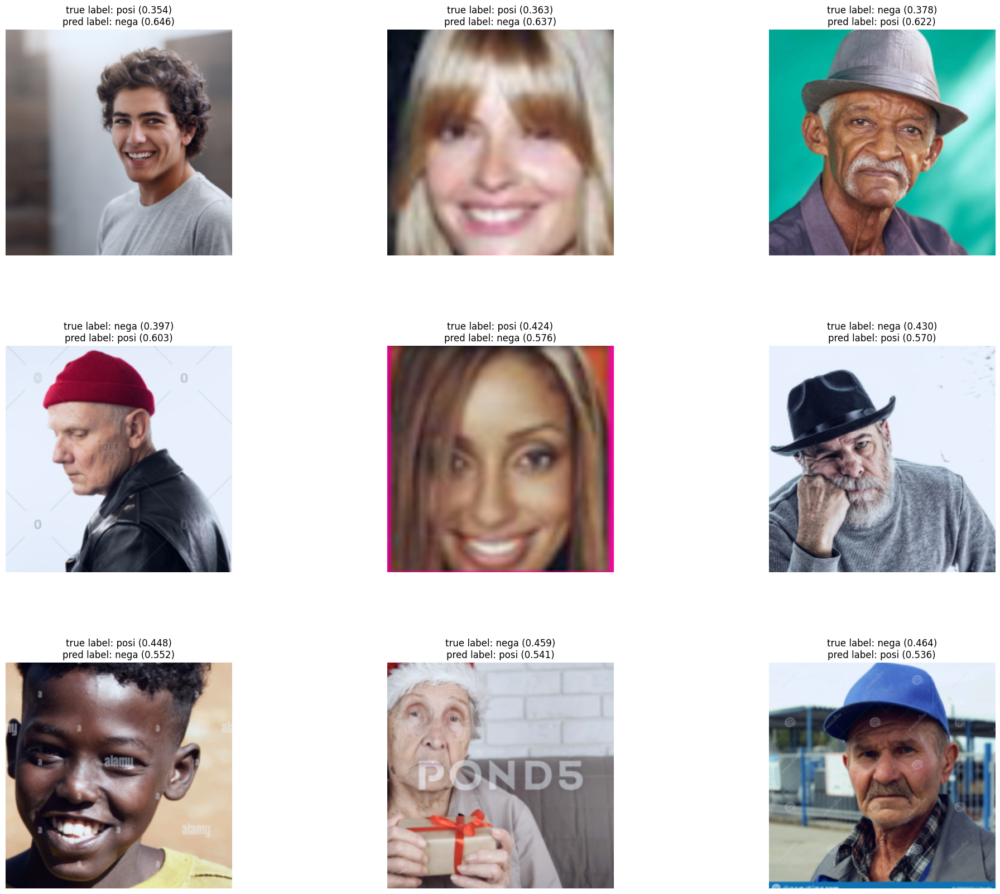

In [590]:
N_IMAGES = len(incorrect_examples)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

#### k_tre

In [591]:
testa_dir=name_dir+'/featureexploredataset/test/k_tre'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [592]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            # y_pred, _ = model(x)
            (y_pred_ensemble, _), log_priors  = model(x)######################################svgd

            y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
            y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            # y_pred=(y_pred_ensemble[0]+y_pred_ensemble[0])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [593]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [594]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([ True, False,  True,  True, False,  True,  True,  True,  True,  True,
        False,  True, False,  True, False,  True, False, False])

In [595]:
len(corrects)- torch.sum(corrects)

tensor(7)

In [596]:
corrects.float().mean()


tensor(0.6111)

In [597]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [598]:
incorrect_examples

[(tensor([[[-0.3369, -0.3027, -0.2342,  ...,  0.9132,  1.0673,  1.1700],
           [-0.2856, -0.2513, -0.1828,  ...,  0.9646,  1.1187,  1.2043],
           [-0.2342, -0.1999, -0.1486,  ...,  1.0331,  1.1529,  1.2385],
           ...,
           [ 0.9132,  0.8447,  0.6906,  ..., -1.4158, -0.7479, -0.3712],
           [ 0.7419,  0.6734,  0.5536,  ..., -1.6727, -0.9705, -0.5596],
           [ 0.5536,  0.4851,  0.3652,  ..., -1.8610, -1.1247, -0.6965]],
  
          [[-0.6001, -0.5826, -0.5651,  ...,  1.0280,  0.6604,  0.4503],
           [-0.5651, -0.5476, -0.5301,  ...,  1.0980,  0.7129,  0.5028],
           [-0.5476, -0.5301, -0.5126,  ...,  1.1506,  0.7654,  0.5378],
           ...,
           [ 0.9230,  0.8179,  0.6429,  ..., -0.7227, -0.9678, -1.1078],
           [ 0.7654,  0.6779,  0.5028,  ..., -0.9503, -1.1954, -1.3179],
           [ 0.5903,  0.5028,  0.3452,  ..., -1.1429, -1.3704, -1.4930]],
  
          [[-0.9330, -0.8981, -0.8458,  ...,  1.3154,  1.1759,  1.1062],
           

In [599]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

1
7


0.14285714285714285

In [600]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

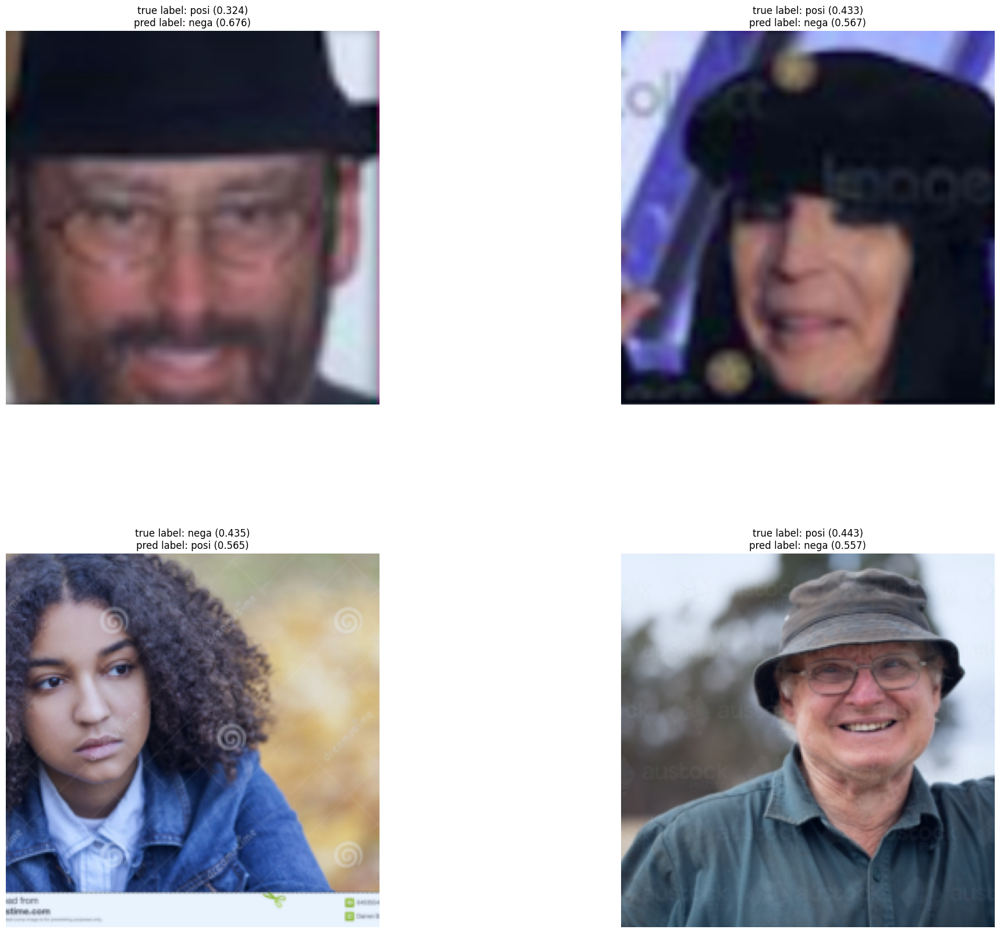

In [601]:
N_IMAGES = len(incorrect_examples)####(labels)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

#### k cuoi

In [602]:
testa_dir=name_dir+'/featureexploredataset/test/kcuoi'
# testa_dir='/content/drive/MyDrive/ambidata/featureexploredataset/testtrain'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [603]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            # y_pred, _ = model(x)
            (y_pred_ensemble, _), log_priors  = model(x)######################################svgd

            y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
            y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            # y_pred=(y_pred_ensemble[1]+y_pred_ensemble[1])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [604]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [605]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([False,  True,  True,  True,  True,  True,  True,  True,  True,  True,
        False, False,  True,  True,  True,  True,  True,  True,  True,  True,
         True,  True, False,  True,  True,  True, False, False,  True,  True,
         True,  True, False,  True,  True,  True,  True,  True, False,  True,
         True,  True,  True, False, False, False, False,  True,  True,  True,
         True,  True, False])

In [606]:
len(corrects)- torch.sum(corrects)

tensor(13)

In [607]:
corrects.float().mean()

tensor(0.7547)

In [608]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:########## cmt nếu muốn show all
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [609]:
incorrect_examples

[(tensor([[[ 1.8550,  1.8550,  1.8722,  ...,  1.9920,  1.9920,  1.9920],
           [ 1.8550,  1.8550,  1.8550,  ...,  1.9920,  1.9920,  1.9920],
           [ 1.8550,  1.8722,  1.8722,  ...,  2.0092,  1.9920,  1.9920],
           ...,
           [ 1.4612,  1.3927,  1.3413,  ...,  0.9474,  0.9303,  0.9132],
           [ 1.4612,  1.3927,  1.3070,  ...,  0.8961,  0.8961,  0.8789],
           [ 1.4440,  1.3755,  1.3070,  ...,  0.8789,  0.8961,  0.8961]],
  
          [[ 2.0784,  2.0784,  2.0959,  ...,  2.2185,  2.2185,  2.2185],
           [ 2.0784,  2.0784,  2.0959,  ...,  2.2185,  2.2185,  2.2185],
           [ 2.0784,  2.0959,  2.0959,  ...,  2.2360,  2.2185,  2.2185],
           ...,
           [ 1.8508,  1.7808,  1.7283,  ...,  0.1527,  0.1527,  0.1352],
           [ 1.8333,  1.7808,  1.7283,  ...,  0.0651,  0.1001,  0.0476],
           [ 1.8158,  1.7633,  1.7283,  ...,  0.0126,  0.0476,  0.0126]],
  
          [[ 2.3960,  2.3960,  2.3960,  ...,  2.5180,  2.5180,  2.5180],
           

In [610]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

0
13


0.0

In [611]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

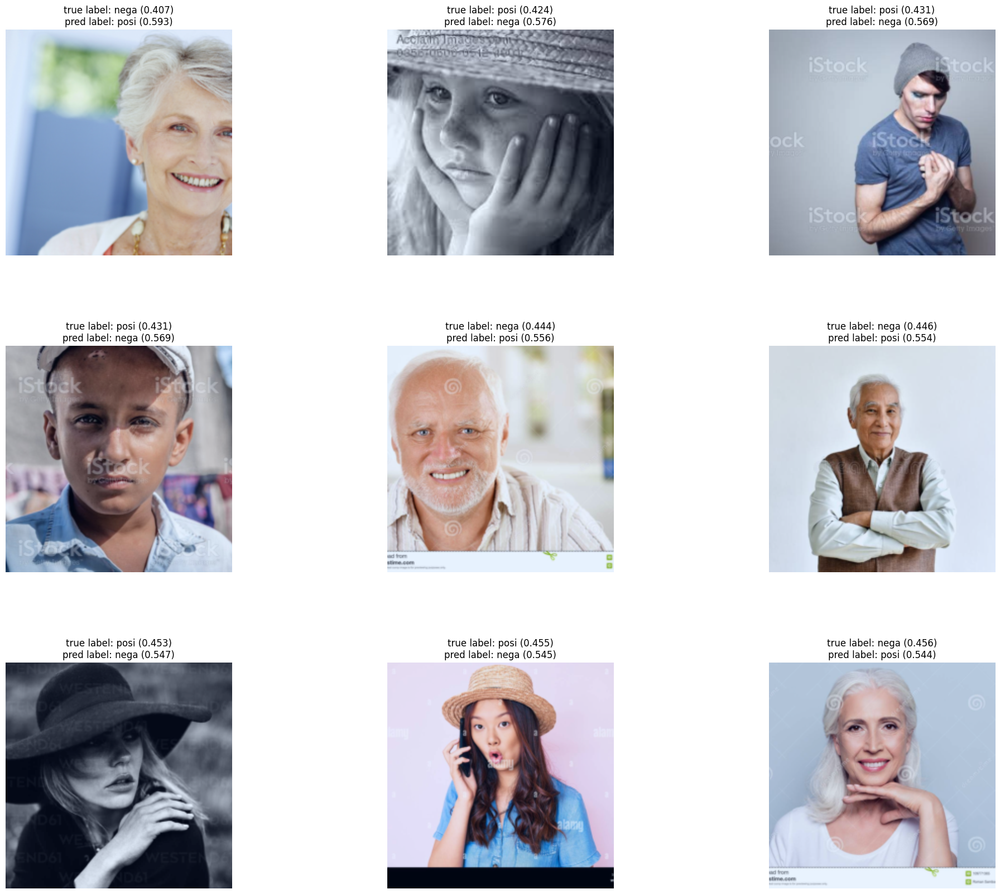

In [612]:
N_IMAGES = len(incorrect_examples)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

## disambiguate

#### k doi mu

In [740]:
testa_dir=name_dir+'/featureexploredataset/test/k_doi_mu'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [741]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            # y_pred, _ = model(x)
            (y_pred_ensemble, _), log_priors  = model(x)######################################svgd

            y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
            # y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            y_pred=(y_pred_ensemble[1]+y_pred_ensemble[1])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [742]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [743]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([False,  True, False, False,  True,  True, False, False,  True, False,
         True,  True,  True, False,  True,  True, False,  True,  True,  True,
        False, False,  True,  True,  True,  True,  True])

In [744]:
len(corrects)- torch.sum(corrects)

tensor(10)

In [745]:
corrects.float().mean()

tensor(0.6296)

In [746]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:########## cmt nếu muốn show all
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [747]:
incorrect_examples

[(tensor([[[ 2.2489,  2.2489,  2.2489,  ...,  2.2489,  2.2489,  2.2489],
           [ 2.2489,  2.2489,  2.2489,  ...,  2.2489,  2.2489,  2.2489],
           [ 2.2489,  2.2489,  2.2489,  ...,  2.2489,  2.2489,  2.2489],
           ...,
           [ 2.2489,  2.2489,  2.2318,  ..., -2.0494, -2.0494, -2.0323],
           [ 2.2489,  2.2489,  2.1462,  ..., -2.0494, -2.0665, -2.0665],
           [ 2.2489,  2.1633,  2.0092,  ..., -2.0494, -2.0837, -2.0837]],
  
          [[ 2.4286,  2.4286,  2.4286,  ...,  2.4286,  2.4286,  2.4286],
           [ 2.4286,  2.4286,  2.4286,  ...,  2.4286,  2.4286,  2.4286],
           [ 2.4286,  2.4286,  2.4286,  ...,  2.4286,  2.4286,  2.4286],
           ...,
           [ 2.4286,  2.4286,  2.4111,  ..., -1.3529, -1.3529, -1.3354],
           [ 2.4286,  2.4286,  2.3235,  ..., -1.3529, -1.3529, -1.3354],
           [ 2.4111,  2.3235,  2.1485,  ..., -1.3529, -1.3354, -1.3354]],
  
          [[ 2.6400,  2.6400,  2.6400,  ...,  2.6400,  2.6400,  2.6400],
           

In [748]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

9
10


0.9

In [749]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

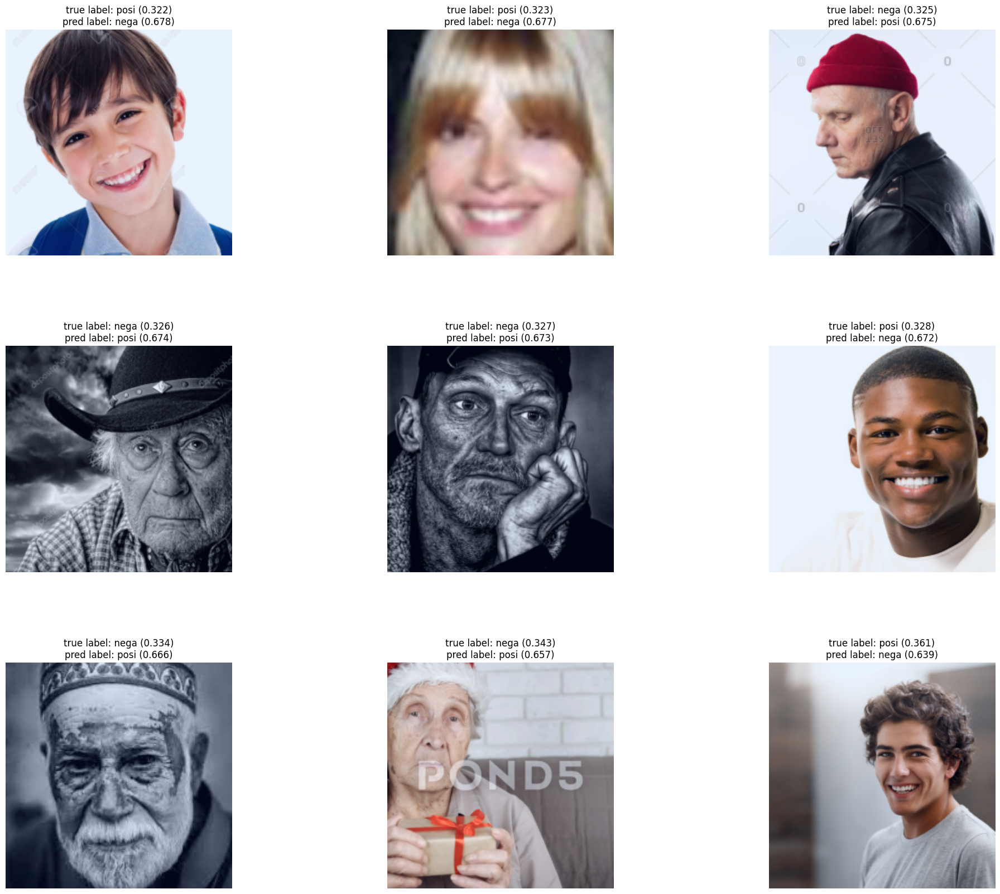

In [750]:
N_IMAGES = len(incorrect_examples)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

#### k_tre

In [778]:
testa_dir=name_dir+'/featureexploredataset/test/k_tre'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [779]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            # y_pred, _ = model(x)
            (y_pred_ensemble, _), log_priors  = model(x)######################################svgd

            y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
            # y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            y_pred=(y_pred_ensemble[0]+y_pred_ensemble[2])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [780]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [781]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([ True,  True,  True,  True, False, False,  True, False,  True,  True,
        False,  True, False,  True,  True,  True, False,  True])

In [782]:
len(corrects)- torch.sum(corrects)

tensor(6)

In [783]:
corrects.float().mean()


tensor(0.6667)

In [784]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [785]:
incorrect_examples

[(tensor([[[-0.3369, -0.3027, -0.2342,  ...,  0.9132,  1.0673,  1.1700],
           [-0.2856, -0.2513, -0.1828,  ...,  0.9646,  1.1187,  1.2043],
           [-0.2342, -0.1999, -0.1486,  ...,  1.0331,  1.1529,  1.2385],
           ...,
           [ 0.9132,  0.8447,  0.6906,  ..., -1.4158, -0.7479, -0.3712],
           [ 0.7419,  0.6734,  0.5536,  ..., -1.6727, -0.9705, -0.5596],
           [ 0.5536,  0.4851,  0.3652,  ..., -1.8610, -1.1247, -0.6965]],
  
          [[-0.6001, -0.5826, -0.5651,  ...,  1.0280,  0.6604,  0.4503],
           [-0.5651, -0.5476, -0.5301,  ...,  1.0980,  0.7129,  0.5028],
           [-0.5476, -0.5301, -0.5126,  ...,  1.1506,  0.7654,  0.5378],
           ...,
           [ 0.9230,  0.8179,  0.6429,  ..., -0.7227, -0.9678, -1.1078],
           [ 0.7654,  0.6779,  0.5028,  ..., -0.9503, -1.1954, -1.3179],
           [ 0.5903,  0.5028,  0.3452,  ..., -1.1429, -1.3704, -1.4930]],
  
          [[-0.9330, -0.8981, -0.8458,  ...,  1.3154,  1.1759,  1.1062],
           

In [786]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

2
6


0.3333333333333333

In [787]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

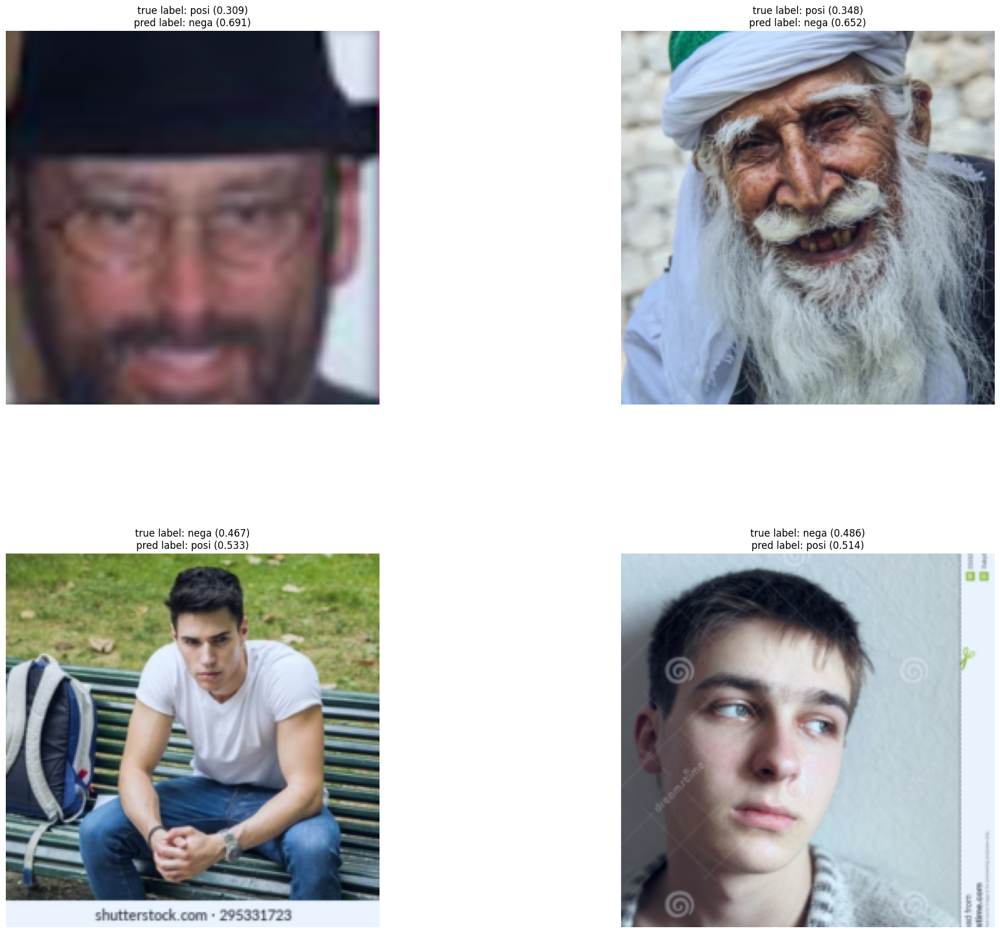

In [788]:
N_IMAGES = len(incorrect_examples)####(labels)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

#### k cuoi

In [808]:
testa_dir=name_dir+'/featureexploredataset/test/kcuoi'
# testa_dir='/content/drive/MyDrive/ambidata/featureexploredataset/testtrain'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [809]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            # y_pred, _ = model(x)
            (y_pred_ensemble, _), log_priors  = model(x)######################################svgd

            y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
            # y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            y_pred=(y_pred_ensemble[1]+y_pred_ensemble[2])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [810]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [811]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([ True,  True,  True,  True,  True,  True,  True,  True, False,  True,
         True, False,  True,  True,  True,  True,  True,  True, False,  True,
         True,  True, False,  True,  True,  True, False,  True,  True, False,
         True, False, False,  True,  True,  True,  True,  True, False,  True,
         True,  True,  True, False, False, False,  True, False,  True, False,
        False,  True, False])

In [812]:
len(corrects)- torch.sum(corrects)

tensor(16)

In [813]:
corrects.float().mean()

tensor(0.6981)

In [814]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:########## cmt nếu muốn show all
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [815]:
incorrect_examples

[(tensor([[[ 1.8550,  1.8550,  1.8722,  ...,  1.9920,  1.9920,  1.9920],
           [ 1.8550,  1.8550,  1.8550,  ...,  1.9920,  1.9920,  1.9920],
           [ 1.8550,  1.8722,  1.8722,  ...,  2.0092,  1.9920,  1.9920],
           ...,
           [ 1.4612,  1.3927,  1.3413,  ...,  0.9474,  0.9303,  0.9132],
           [ 1.4612,  1.3927,  1.3070,  ...,  0.8961,  0.8961,  0.8789],
           [ 1.4440,  1.3755,  1.3070,  ...,  0.8789,  0.8961,  0.8961]],
  
          [[ 2.0784,  2.0784,  2.0959,  ...,  2.2185,  2.2185,  2.2185],
           [ 2.0784,  2.0784,  2.0959,  ...,  2.2185,  2.2185,  2.2185],
           [ 2.0784,  2.0959,  2.0959,  ...,  2.2360,  2.2185,  2.2185],
           ...,
           [ 1.8508,  1.7808,  1.7283,  ...,  0.1527,  0.1527,  0.1352],
           [ 1.8333,  1.7808,  1.7283,  ...,  0.0651,  0.1001,  0.0476],
           [ 1.8158,  1.7633,  1.7283,  ...,  0.0126,  0.0476,  0.0126]],
  
          [[ 2.3960,  2.3960,  2.3960,  ...,  2.5180,  2.5180,  2.5180],
           

In [817]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

5
16


0.3125

In [818]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

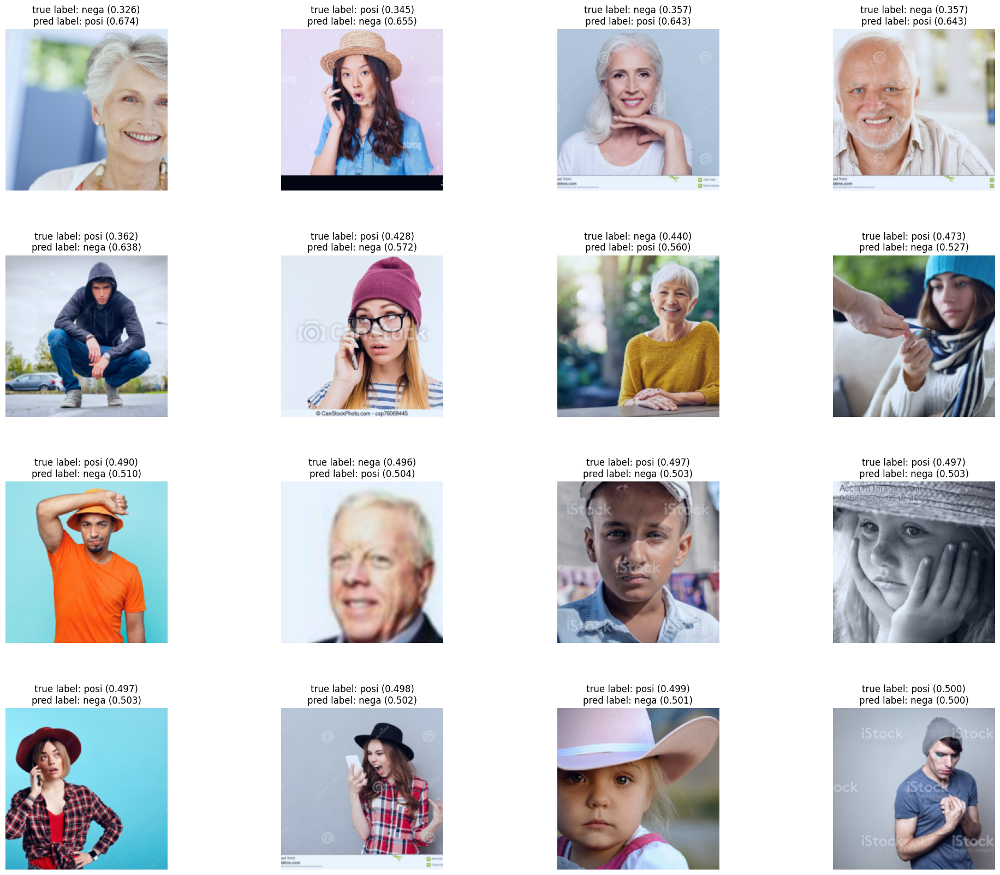

In [819]:
N_IMAGES = len(incorrect_examples)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

## Target test

#### k doi mu

In [646]:
testa_dir=name_dir+'/featureexploredataset/targettest/k_doi_mu'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [647]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            # y_pred, _ = model(x)
            (y_pred_ensemble, _), log_priors  = model(x)######################################svgd

            y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
            y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            # y_pred=(y_pred_ensemble[2]+y_pred_ensemble[2])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [648]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [649]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([ True,  True,  True,  True, False, False,  True,  True,  True,  True,
        False, False, False,  True, False,  True,  True, False, False,  True,
        False,  True, False,  True, False, False, False, False,  True, False,
         True, False,  True,  True, False,  True, False,  True,  True, False,
        False, False, False,  True,  True, False,  True,  True,  True,  True,
        False,  True,  True, False, False,  True,  True,  True,  True, False,
        False,  True,  True, False, False,  True,  True, False,  True,  True,
        False,  True, False,  True, False, False,  True,  True, False,  True,
        False, False,  True,  True, False,  True,  True,  True,  True,  True,
         True,  True, False, False,  True,  True,  True, False,  True,  True,
        False,  True,  True,  True,  True,  True,  True,  True, False,  True,
         True,  True,  True,  True, False,  True,  True,  True,  True,  True,
         True,  True,  True,  True, False,  True,  True,  True, 

In [650]:
len(corrects)- torch.sum(corrects)

tensor(50)

In [651]:
corrects.float().mean()

tensor(0.7585)

In [652]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:########## cmt nếu muốn show all
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [653]:
incorrect_examples

[(tensor([[[ 0.2453,  0.2282,  0.2282,  ...,  0.1083,  0.1768,  0.1768],
           [ 0.2111,  0.2111,  0.2282,  ...,  0.1083,  0.1254,  0.1254],
           [ 0.2282,  0.2282,  0.2282,  ...,  0.0569,  0.0912,  0.0912],
           ...,
           [-2.1008, -2.1008, -2.1008,  ..., -2.1008, -2.1008, -2.1008],
           [-2.1008, -2.1008, -2.1008,  ..., -2.1008, -2.1008, -2.1008],
           [-2.1008, -2.1008, -2.1008,  ..., -2.1008, -2.1008, -2.1008]],
  
          [[ 1.9559,  1.9384,  1.9384,  ...,  1.9384,  1.9034,  1.9034],
           [ 1.9209,  1.9209,  1.9384,  ...,  1.9384,  1.9209,  1.9209],
           [ 1.9384,  1.9384,  1.9384,  ...,  1.9034,  1.9384,  1.9209],
           ...,
           [-2.0182, -2.0182, -2.0182,  ..., -2.0182, -2.0182, -2.0182],
           [-2.0182, -2.0182, -2.0182,  ..., -2.0182, -2.0182, -2.0182],
           [-2.0182, -2.0182, -2.0182,  ..., -2.0182, -2.0182, -2.0182]],
  
          [[ 2.6226,  2.6051,  2.6226,  ...,  2.6226,  2.6226,  2.6226],
           

In [654]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

22
50


0.44

In [655]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

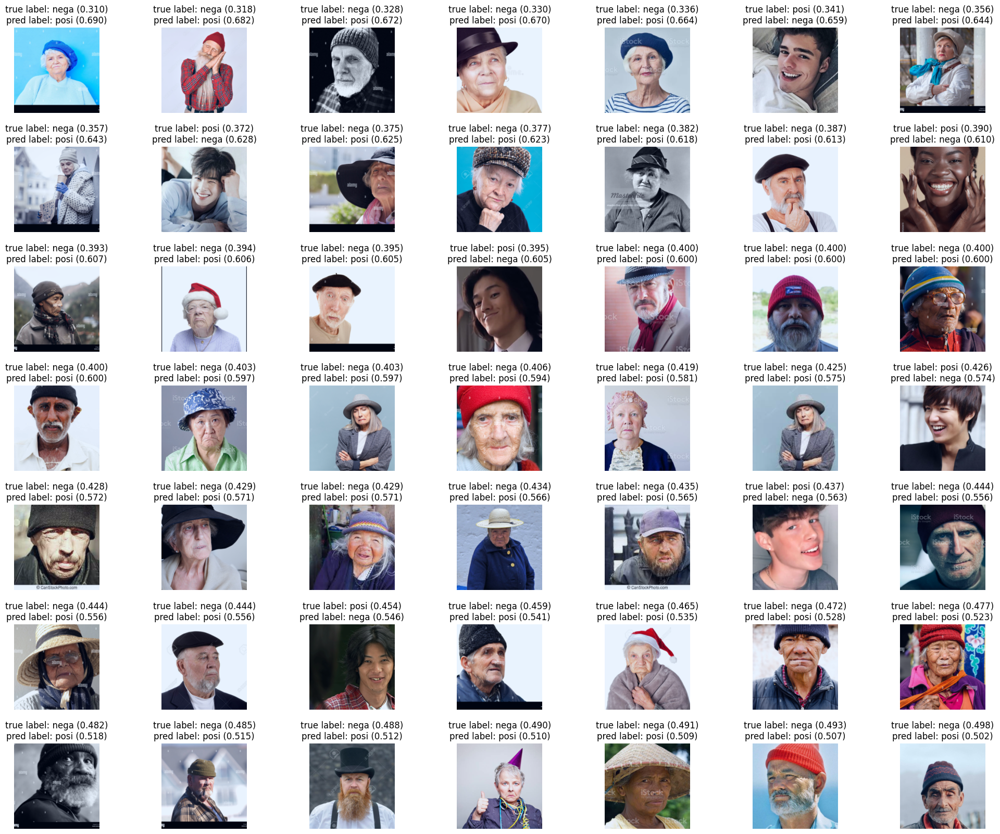

In [656]:
N_IMAGES = len(incorrect_examples)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

#### k_tre

In [657]:
testa_dir=name_dir+'/featureexploredataset/targettest/k_tre'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [658]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            # y_pred, _ = model(x)
            (y_pred_ensemble, _), log_priors  = model(x)######################################svgd

            y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
            y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            # y_pred=(y_pred_ensemble[0]+y_pred_ensemble[0])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [659]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [660]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([False, False,  True, False, False, False, False, False,  True,  True,
        False, False, False, False,  True,  True, False, False,  True,  True,
        False,  True,  True, False, False, False,  True,  True, False, False,
        False, False, False,  True, False,  True, False, False, False, False,
         True,  True, False,  True, False, False, False, False,  True, False,
        False,  True, False, False, False,  True,  True,  True,  True, False,
        False,  True,  True,  True,  True,  True, False, False, False,  True,
         True,  True, False, False, False,  True, False, False, False, False,
         True,  True,  True, False, False,  True,  True,  True,  True,  True,
        False, False, False, False,  True,  True, False, False, False,  True,
         True, False, False, False,  True, False,  True, False,  True,  True,
         True,  True,  True, False,  True,  True, False,  True,  True,  True,
        False,  True,  True,  True, False,  True,  True,  True, 

In [661]:
len(corrects)- torch.sum(corrects)

tensor(91)

In [662]:
corrects.float().mean()


tensor(0.5767)

In [663]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [664]:
incorrect_examples

[(tensor([[[-1.7754, -1.8097, -1.8268,  ...,  0.4679, -0.7137, -1.3987],
           [-1.7754, -1.8097, -1.8268,  ...,  0.8104, -0.0116, -1.0733],
           [-1.7754, -1.7925, -1.7754,  ...,  0.7419,  0.5536, -0.5424],
           ...,
           [-1.9295, -1.9295, -1.9124,  ..., -1.8097, -1.9124, -1.9295],
           [-1.9295, -1.9295, -1.9124,  ..., -1.7412, -1.8610, -1.9124],
           [-1.9295, -1.9124, -1.9124,  ..., -1.6727, -1.8268, -1.8953]],
  
          [[-1.6681, -1.6856, -1.6681,  ...,  0.4503, -0.6702, -1.2829],
           [-1.6681, -1.7031, -1.6681,  ...,  0.7829,  0.0126, -0.9678],
           [-1.6681, -1.6856, -1.6506,  ...,  0.6954,  0.5378, -0.4776],
           ...,
           [-1.8256, -1.8256, -1.8081,  ..., -1.6331, -1.7556, -1.7906],
           [-1.8256, -1.8256, -1.8081,  ..., -1.5805, -1.7031, -1.7731],
           [-1.8256, -1.8081, -1.8081,  ..., -1.5105, -1.6681, -1.7556]],
  
          [[-1.4036, -1.4036, -1.4210,  ...,  0.3568, -0.5844, -1.1073],
           

In [665]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

31
91


0.34065934065934067

In [666]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

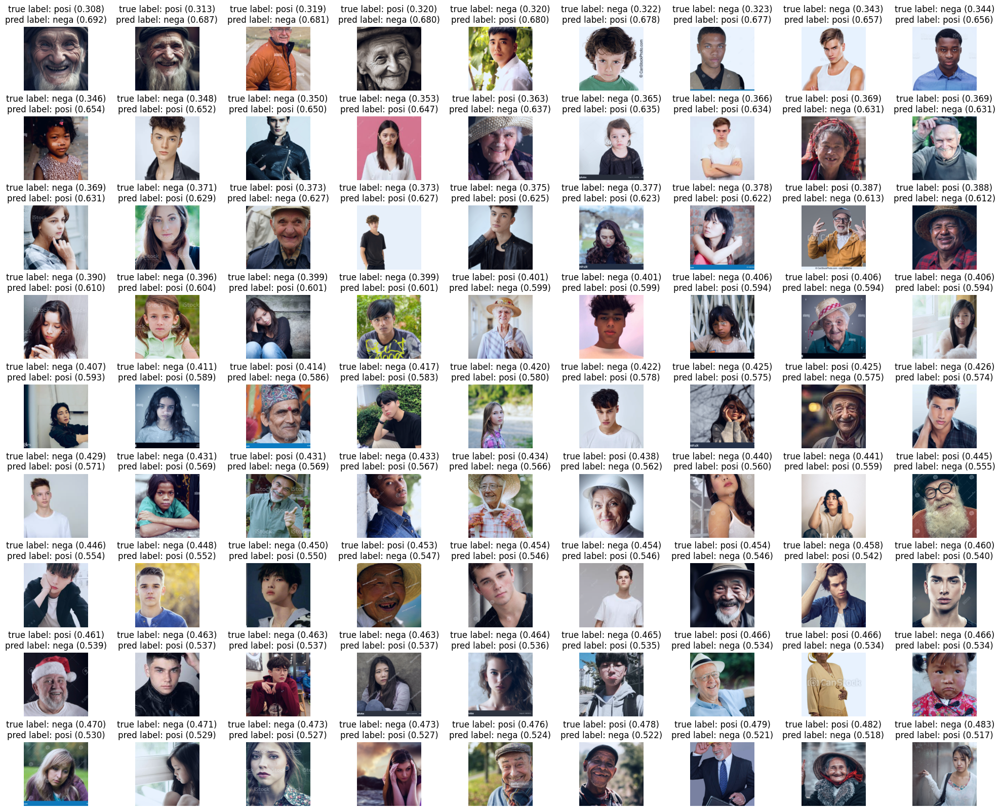

In [667]:
N_IMAGES = len(incorrect_examples)####(labels)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

#### k cuoi

In [668]:
testa_dir=name_dir+'/featureexploredataset/targettest/kcuoi'
# testa_dir='/content/drive/MyDrive/ambidata/featureexploredataset/testtrain'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [669]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            # y_pred, _ = model(x)
            (y_pred_ensemble, _), log_priors  = model(x)######################################svgd

            y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
            y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            # y_pred=(y_pred_ensemble[1]+y_pred_ensemble[1])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [670]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [671]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([ True, False, False,  True,  True, False,  True, False,  True,  True,
         True,  True,  True,  True, False, False,  True,  True,  True,  True,
         True, False, False,  True,  True,  True,  True, False, False,  True,
         True,  True, False,  True,  True, False,  True,  True,  True,  True,
         True,  True, False,  True,  True,  True,  True,  True, False,  True,
        False,  True,  True, False, False,  True,  True, False, False,  True,
         True, False, False,  True,  True, False, False,  True,  True,  True,
         True, False,  True,  True, False,  True,  True,  True,  True,  True,
        False,  True,  True,  True,  True,  True, False, False, False,  True,
         True, False,  True,  True,  True,  True,  True,  True, False,  True,
         True,  True,  True,  True,  True,  True, False, False, False,  True,
         True,  True,  True,  True,  True,  True,  True,  True,  True,  True,
         True,  True, False,  True,  True,  True,  True,  True, 

In [672]:
len(corrects)- torch.sum(corrects)

tensor(42)

In [673]:
corrects.float().mean()

tensor(0.7868)

In [674]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:########## cmt nếu muốn show all
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [675]:
incorrect_examples

[(tensor([[[ 1.0673,  1.0844,  1.3413,  ...,  0.3652, -0.0972, -0.6281],
           [ 1.2557,  1.2214,  1.3413,  ...,  0.6734, -0.0629, -0.6281],
           [ 1.0673,  1.0159,  0.9817,  ...,  0.6563, -0.3369, -0.9020],
           ...,
           [-1.4329, -1.4329, -1.4329,  ..., -1.4329, -1.4329, -1.4329],
           [-1.4329, -1.4329, -1.4329,  ..., -1.4329, -1.4329, -1.4329],
           [-1.4329, -1.4329, -1.4329,  ..., -1.4329, -1.4329, -1.4329]],
  
          [[ 1.8158,  1.7458,  1.8683,  ...,  1.3957,  1.0455,  0.5203],
           [ 1.9209,  1.8859,  1.9209,  ...,  1.6057,  1.0280,  0.4678],
           [ 1.7108,  1.6933,  1.6758,  ...,  1.5707,  0.6954,  0.0476],
           ...,
           [-1.2129, -1.2129, -1.2129,  ..., -1.2129, -1.2129, -1.2129],
           [-1.2129, -1.2129, -1.2129,  ..., -1.2129, -1.2129, -1.2129],
           [-1.2129, -1.2129, -1.2129,  ..., -1.2129, -1.2129, -1.2129]],
  
          [[ 0.9319,  0.8797,  1.2457,  ..., -0.4798, -0.6018, -0.9853],
           

In [676]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

18
42


0.42857142857142855

In [677]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

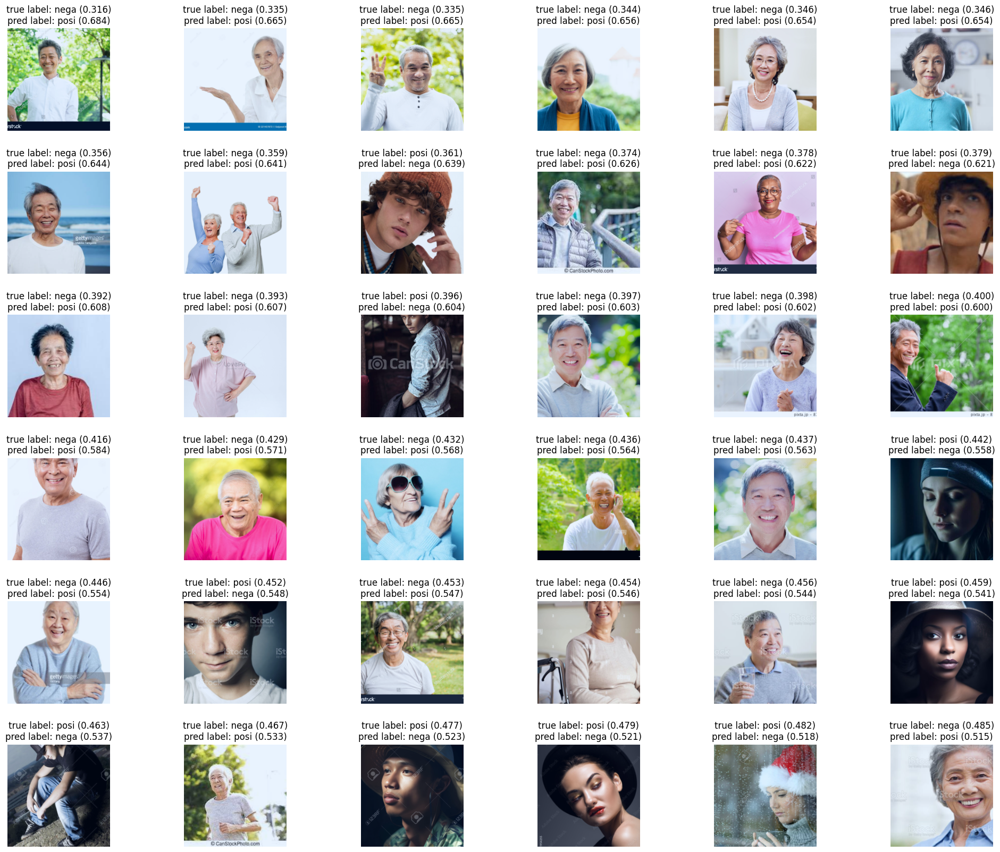

In [678]:
N_IMAGES = len(incorrect_examples)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

## disambiguite Target test

#### k doi mu

In [712]:
testa_dir=name_dir+'/featureexploredataset/targettest/k_doi_mu'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [730]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            # y_pred, _ = model(x)
            (y_pred_ensemble, _), log_priors  = model(x)######################################svgd

            y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
            # y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            y_pred=(y_pred_ensemble[1]+y_pred_ensemble[1])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [731]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [732]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([ True,  True, False,  True, False, False,  True, False,  True,  True,
        False,  True,  True,  True, False,  True,  True, False,  True,  True,
        False, False, False,  True, False,  True, False, False,  True,  True,
         True, False,  True,  True,  True,  True,  True,  True,  True, False,
         True, False, False,  True,  True, False,  True,  True,  True, False,
        False,  True,  True,  True,  True,  True,  True,  True,  True, False,
        False,  True,  True, False, False,  True,  True, False,  True,  True,
        False,  True,  True,  True, False, False,  True,  True, False,  True,
        False, False,  True,  True, False,  True,  True,  True,  True,  True,
         True,  True,  True,  True,  True,  True,  True, False,  True,  True,
        False, False,  True,  True,  True,  True,  True,  True,  True,  True,
         True,  True,  True,  True, False,  True,  True,  True,  True,  True,
         True,  True,  True,  True, False, False,  True,  True, 

In [733]:
len(corrects)- torch.sum(corrects)

tensor(43)

In [734]:
corrects.float().mean()

tensor(0.7923)

In [735]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:########## cmt nếu muốn show all
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [736]:
incorrect_examples

[(tensor([[[ 1.1700,  1.2043,  1.2043,  ...,  1.2214,  1.2214,  1.2214],
           [ 1.1700,  1.2043,  1.2043,  ...,  1.2214,  1.2214,  1.2214],
           [ 1.1700,  1.2043,  1.2043,  ...,  1.2214,  1.2214,  1.2214],
           ...,
           [ 0.5364,  0.8618,  1.3755,  ...,  0.9303,  0.8618,  0.7933],
           [-0.3369, -0.6794,  0.1768,  ...,  0.8961,  0.8276,  0.7591],
           [-0.5767, -1.1589, -0.7479,  ...,  0.8961,  0.8276,  0.7591]],
  
          [[ 1.5007,  1.5357,  1.5357,  ...,  1.5532,  1.5532,  1.5532],
           [ 1.5007,  1.5357,  1.5357,  ...,  1.5532,  1.5532,  1.5532],
           [ 1.5007,  1.5357,  1.5357,  ...,  1.5532,  1.5532,  1.5532],
           ...,
           [ 0.9580,  1.4482,  2.0259,  ...,  1.3606,  1.3256,  1.2556],
           [ 0.1176, -0.0574,  0.8880,  ...,  1.3256,  1.2906,  1.2206],
           [-0.0749, -0.5126, -0.0399,  ...,  1.3256,  1.2906,  1.2206]],
  
          [[ 1.7511,  1.7860,  1.7860,  ...,  1.8034,  1.8034,  1.8034],
           

In [737]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

28
43


0.6511627906976745

In [738]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

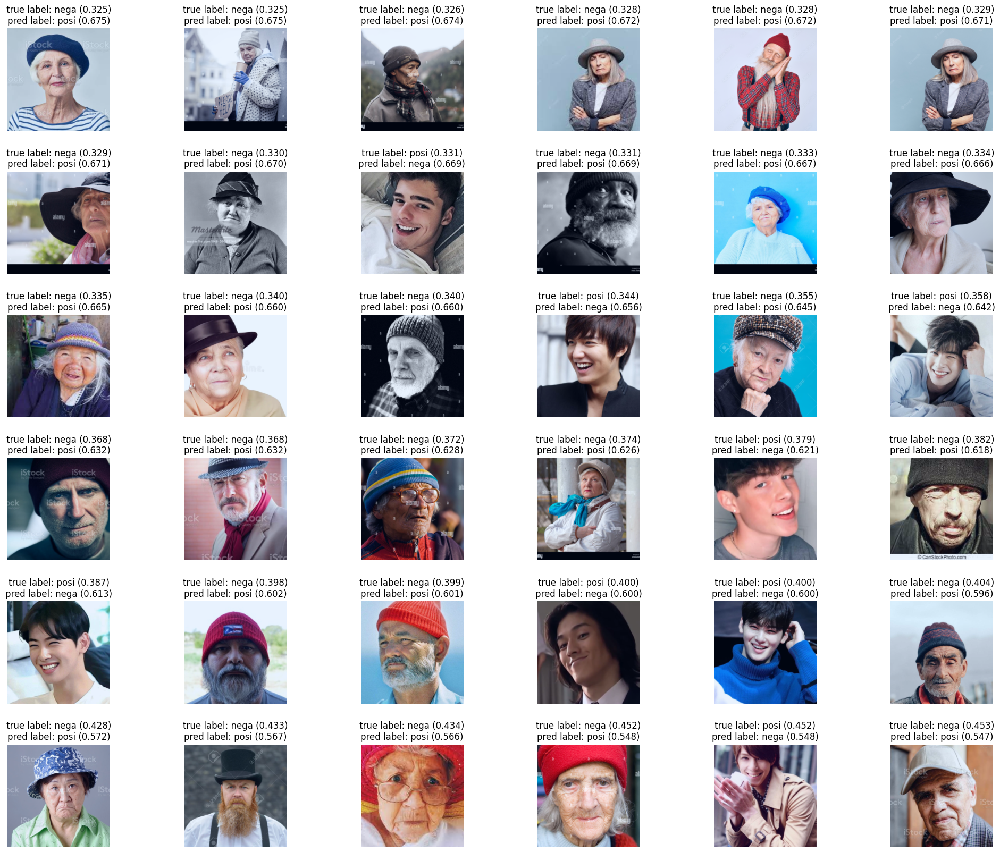

In [739]:
N_IMAGES = len(incorrect_examples)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

#### k_tre

In [751]:
testa_dir=name_dir+'/featureexploredataset/targettest/k_tre'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [768]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            # y_pred, _ = model(x)
            (y_pred_ensemble, _), log_priors  = model(x)######################################svgd

            y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
            # y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            y_pred=(y_pred_ensemble[0]+y_pred_ensemble[2])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [769]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [770]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([False, False,  True, False, False, False, False, False,  True, False,
        False, False,  True,  True,  True,  True,  True,  True,  True,  True,
         True,  True,  True, False,  True, False,  True,  True,  True,  True,
        False, False,  True,  True, False,  True, False,  True, False, False,
         True,  True,  True,  True, False, False, False, False,  True, False,
         True,  True, False,  True,  True,  True,  True,  True,  True, False,
         True,  True,  True,  True,  True,  True, False, False, False,  True,
         True,  True, False, False, False,  True, False,  True, False, False,
         True,  True,  True,  True,  True,  True,  True,  True,  True,  True,
        False, False, False, False,  True,  True, False, False, False, False,
         True,  True, False, False,  True, False,  True, False,  True,  True,
        False, False,  True, False,  True,  True, False, False,  True,  True,
        False, False,  True,  True, False,  True,  True, False, 

In [771]:
len(corrects)- torch.sum(corrects)

tensor(78)

In [772]:
corrects.float().mean()


tensor(0.6372)

In [773]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [774]:
incorrect_examples

[(tensor([[[-1.7754, -1.8097, -1.8268,  ...,  0.4679, -0.7137, -1.3987],
           [-1.7754, -1.8097, -1.8268,  ...,  0.8104, -0.0116, -1.0733],
           [-1.7754, -1.7925, -1.7754,  ...,  0.7419,  0.5536, -0.5424],
           ...,
           [-1.9295, -1.9295, -1.9124,  ..., -1.8097, -1.9124, -1.9295],
           [-1.9295, -1.9295, -1.9124,  ..., -1.7412, -1.8610, -1.9124],
           [-1.9295, -1.9124, -1.9124,  ..., -1.6727, -1.8268, -1.8953]],
  
          [[-1.6681, -1.6856, -1.6681,  ...,  0.4503, -0.6702, -1.2829],
           [-1.6681, -1.7031, -1.6681,  ...,  0.7829,  0.0126, -0.9678],
           [-1.6681, -1.6856, -1.6506,  ...,  0.6954,  0.5378, -0.4776],
           ...,
           [-1.8256, -1.8256, -1.8081,  ..., -1.6331, -1.7556, -1.7906],
           [-1.8256, -1.8256, -1.8081,  ..., -1.5805, -1.7031, -1.7731],
           [-1.8256, -1.8081, -1.8081,  ..., -1.5105, -1.6681, -1.7556]],
  
          [[-1.4036, -1.4036, -1.4210,  ...,  0.3568, -0.5844, -1.1073],
           

In [775]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

33
78


0.4230769230769231

In [776]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

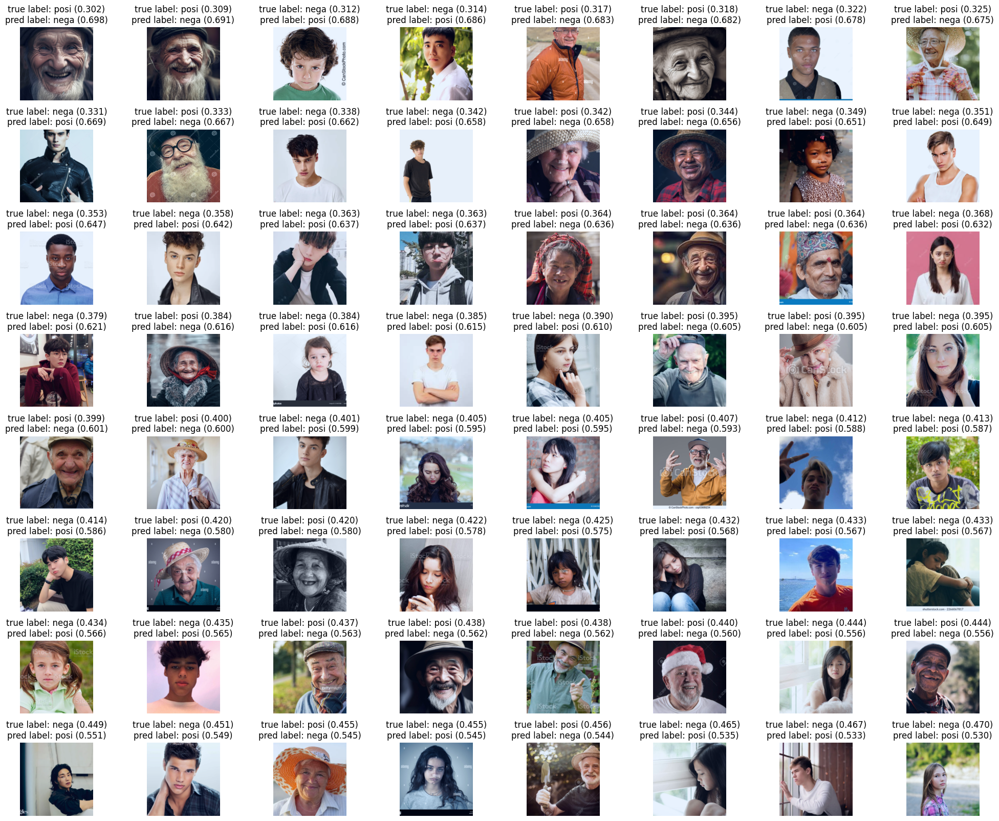

In [777]:
N_IMAGES = len(incorrect_examples)####(labels)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)

#### k cuoi

In [789]:
testa_dir=name_dir+'/featureexploredataset/targettest/kcuoi'
# testa_dir='/content/drive/MyDrive/ambidata/featureexploredataset/testtrain'
BATCH_SIZEa=1
testa_data = datasets.ImageFolder(root = testa_dir,
                                 transform = test_transforms)
testa_iterator = data.DataLoader(testa_data,
                                batch_size = BATCH_SIZEa)

In [798]:
def get_predictions(model, iterator):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            # y_pred, _ = model(x)
            (y_pred_ensemble, _), log_priors  = model(x)######################################svgd

            y_pred_ensemble=y_pred_ensemble.softmax(dim=-1)
            # y_pred=y_pred_ensemble.mean(dim=0)######################################svgd
            y_pred=(y_pred_ensemble[1]+y_pred_ensemble[2])/2.0######################################svgd


            y_prob = F.softmax(y_pred, dim = -1)
            top_pred = y_prob.argmax(1, keepdim = True)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim = 0)
    labels = torch.cat(labels, dim = 0)
    probs = torch.cat(probs, dim = 0)

    return images, labels, probs

In [799]:
images, labels, probs = get_predictions(model, testa_iterator)
pred_labels = torch.argmax(probs, 1)

In [800]:
corrects = torch.eq(labels, pred_labels)
corrects

tensor([ True, False,  True, False,  True, False,  True,  True,  True,  True,
         True, False,  True,  True,  True, False,  True,  True,  True,  True,
         True, False, False,  True,  True,  True,  True, False, False,  True,
         True, False,  True,  True,  True, False,  True,  True,  True,  True,
         True,  True, False,  True,  True,  True,  True,  True, False,  True,
         True,  True,  True,  True, False,  True,  True, False, False,  True,
         True, False, False,  True,  True, False, False,  True,  True,  True,
         True, False,  True,  True, False,  True,  True,  True,  True,  True,
        False,  True,  True,  True,  True,  True, False, False, False,  True,
         True,  True,  True,  True,  True,  True,  True,  True,  True,  True,
         True,  True,  True,  True,  True,  True,  True,  True, False,  True,
         True,  True,  True,  True,  True,  True,  True,  True,  True,  True,
         True,  True, False,  True,  True,  True,  True,  True, 

In [801]:
len(corrects)- torch.sum(corrects)

tensor(35)

In [802]:
corrects.float().mean()

tensor(0.8223)

In [803]:
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:########## cmt nếu muốn show all
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse = True, key = lambda x: torch.max(x[2], dim = 0).values)

In [804]:
incorrect_examples

[(tensor([[[ 1.0673,  1.0844,  1.3413,  ...,  0.3652, -0.0972, -0.6281],
           [ 1.2557,  1.2214,  1.3413,  ...,  0.6734, -0.0629, -0.6281],
           [ 1.0673,  1.0159,  0.9817,  ...,  0.6563, -0.3369, -0.9020],
           ...,
           [-1.4329, -1.4329, -1.4329,  ..., -1.4329, -1.4329, -1.4329],
           [-1.4329, -1.4329, -1.4329,  ..., -1.4329, -1.4329, -1.4329],
           [-1.4329, -1.4329, -1.4329,  ..., -1.4329, -1.4329, -1.4329]],
  
          [[ 1.8158,  1.7458,  1.8683,  ...,  1.3957,  1.0455,  0.5203],
           [ 1.9209,  1.8859,  1.9209,  ...,  1.6057,  1.0280,  0.4678],
           [ 1.7108,  1.6933,  1.6758,  ...,  1.5707,  0.6954,  0.0476],
           ...,
           [-1.2129, -1.2129, -1.2129,  ..., -1.2129, -1.2129, -1.2129],
           [-1.2129, -1.2129, -1.2129,  ..., -1.2129, -1.2129, -1.2129],
           [-1.2129, -1.2129, -1.2129,  ..., -1.2129, -1.2129, -1.2129]],
  
          [[ 0.9319,  0.8797,  1.2457,  ..., -0.4798, -0.6018, -0.9853],
           

In [805]:
count=0
for i in incorrect_examples:
  if(max(i[2].numpy())>=0.6):
    count+=1
print(count)
print(len(incorrect_examples))
count/len(incorrect_examples)

22
35


0.6285714285714286

In [806]:
def plot_most_incorrect(incorrect, classes, n_images, normalize = True):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize = (25, 20))

    for i in range(rows*cols):

        ax = fig.add_subplot(rows, cols, i+1)

        image, true_label, probs = incorrect[i]
        image = image.permute(1, 2, 0)
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim = 0)
        true_class = classes[true_label]
        incorrect_class = classes[incorrect_label]

        if normalize:
            image = normalize_image(image)

        ax.imshow(image.cpu().numpy())
        ax.set_title(f'true label: {true_class} ({true_prob:.3f})\n' \
                     f'pred label: {incorrect_class} ({incorrect_prob:.3f})')
        ax.axis('off')

    fig.subplots_adjust(hspace=0.4)

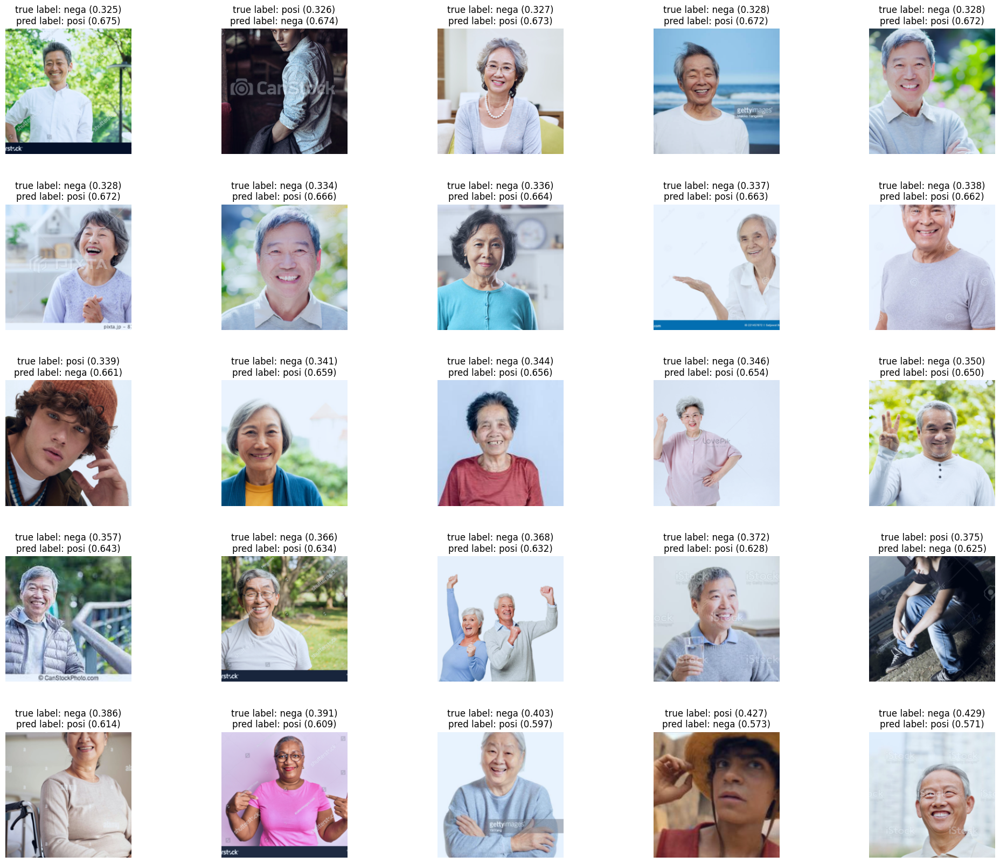

In [807]:
N_IMAGES = len(incorrect_examples)

plot_most_incorrect(incorrect_examples, classes, N_IMAGES)